<br>
<font>
<div dir="ltr" align="center">
    <br>
    <font color="#E74C3C" size="7" style="font-family:Arial, sans-serif;">
        Basic Concepts & Image Mnupulation <br>
    </font>
    <font color="#2980B9" size="6" style="font-family:Arial, sans-serif;">
        Computer Vision <br>
    </font>
    <font color="#2980B9" size="5" style="font-family:Arial, sans-serif;">
        Dr. Mahdi Seyfipoor <br>
    </font>
    <font color="#2980B9" size="5" style="font-family:Arial, sans-serif;">
        Solution by Amir Vahedi <br>
    </font>
</div>

### 

<font>
<div dir="ltr" align="center">
    <br>
    <font color="green" size="7" style="font-family:Arial, sans-serif;">
        Question #1<br>
    </font>
</div>


#### Importing Required Libraries

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image
from IPython.display import Image
import cv2

#### Loading and Displaying Images

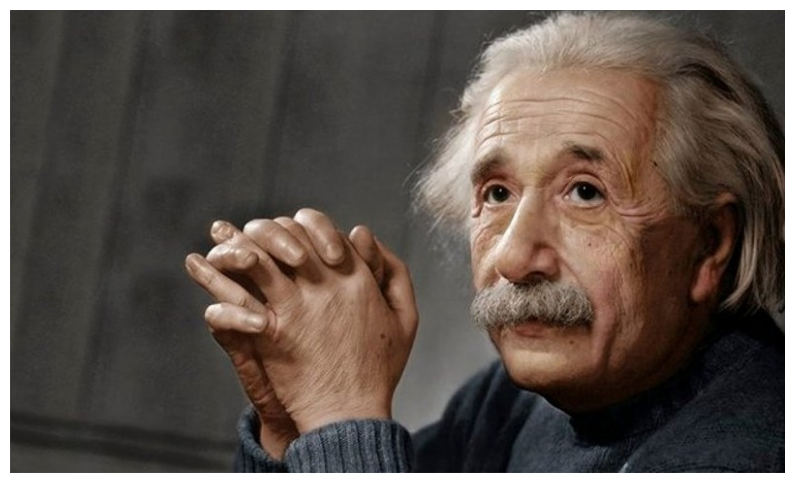

In [3]:
# Loading image
image = cv2.imread("Einstein.jpeg")

# Converting Color Map from BGR to RGB
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Dispalying image
plt.figure(figsize=(10, 10))
plt.imshow(image)
plt.axis("off")
plt.show()

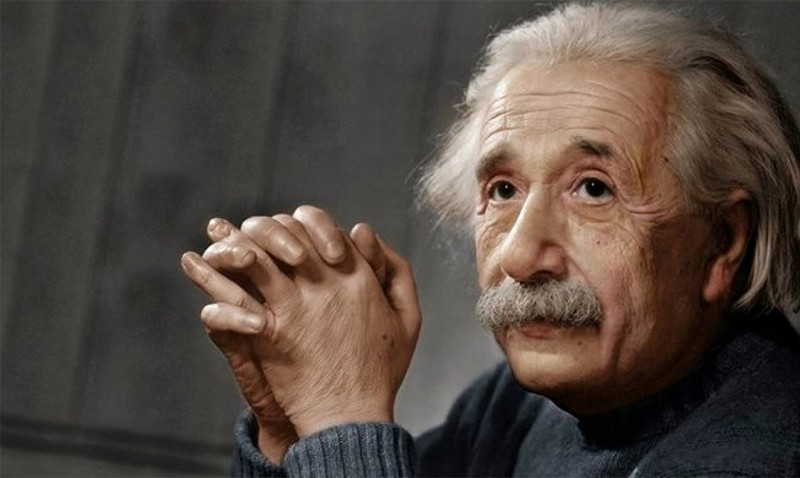

In [4]:
# Simpler way to display images
Image(filename="Einstein.jpeg")

In [5]:
# Getting familiar with image data structure
print(image.shape)
print(type(image))
print(type(image[0, 0, 0]))

(478, 800, 3)
<class 'numpy.ndarray'>
<class 'numpy.uint8'>


#### Grayscale Images

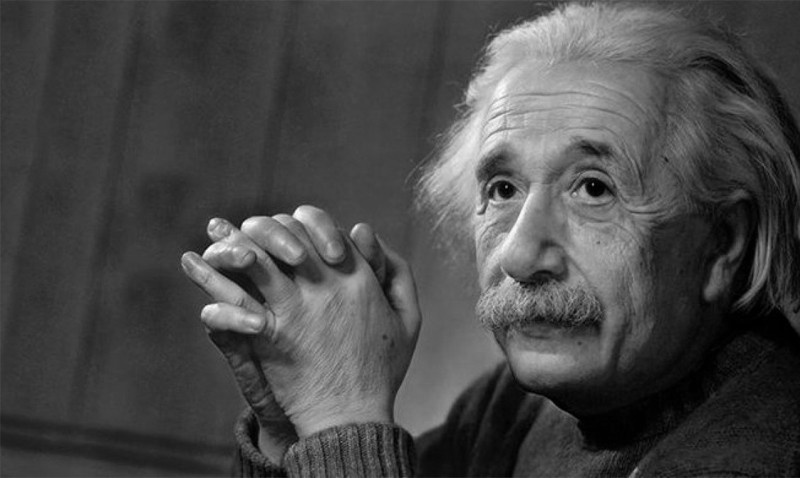

In [6]:
# Grayscale image: Without OpenCV
image_gray = image.mean(axis=2)

# Saving and Displaying
cv2.imwrite("Question #1/Einstein_Gray.jpeg", image_gray)
Image(filename="Question #1/Einstein_Gray.jpeg")

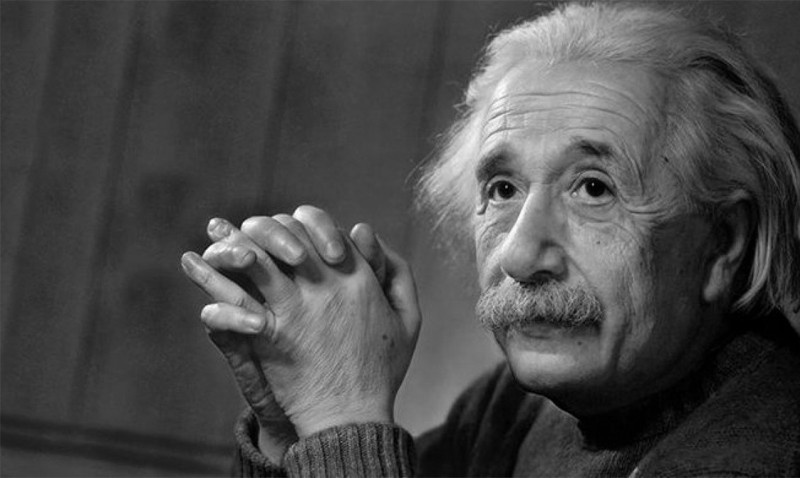

In [7]:
# Grayscale image: Using OpenCV
image_gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)

# Saving and Displaying
cv2.imwrite("Question #1/Einstein_Gray.jpeg", image_gray)
Image(filename="Question #1/Einstein_Gray.jpeg")

#### Binary Images

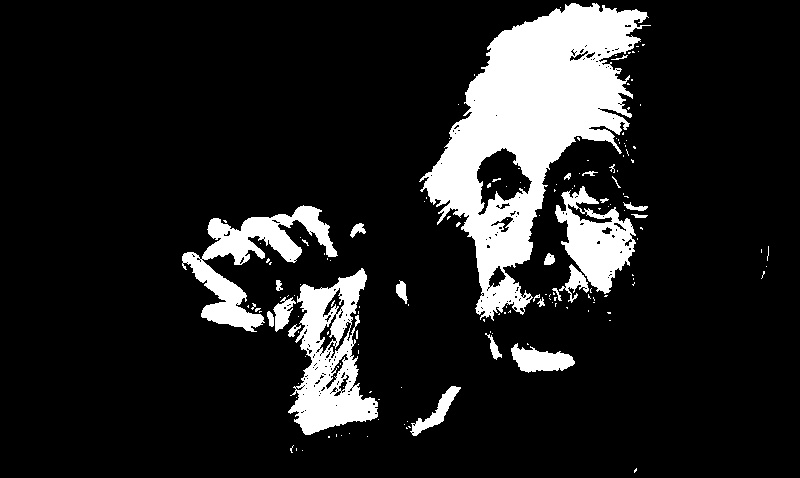

In [8]:
# Binary Image: Using OpneCV
image_binary = cv2.threshold(image_gray, 127, 255, cv2.THRESH_BINARY)  # -> tuple
# image_binary -> Type: tuple
#       >>> First element: threshold
#       >>> Second element: binary image

# Saving and Displaying
cv2.imwrite("Question #1/Einstein_Binary.jpeg", image_binary[1])
Image(filename="Question #1/Einstein_Binary.jpeg")

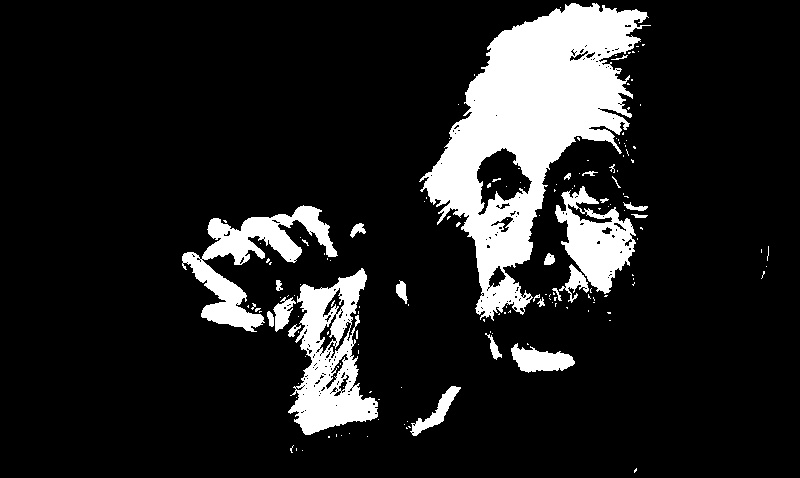

In [9]:
# Binary Image: Without Using OpenCV
image_binary = image_gray.copy()
image_binary[image_binary > 127] = 255
image_binary[image_binary <= 127] = 0

# Saving and Displaying
cv2.imwrite("Question #1/Einstein_Binary.jpeg", image_binary)
Image(filename="Question #1/Einstein_Binary.jpeg")

#### Dealing with Image Contrast and Histogram

In [10]:
def adjust_contrast(image, factor):
    """
    Adjust the contrast of an image.

    Parameters:
    - image: Input image as a NumPy array.
    - factor: Contrast adjustment factor (1.0 means no change,
              less than 1.0 decreases contrast, greater than 1.0 increases contrast).

    Returns:
    - Image with adjusted contrast as a NumPy array.
    """
    # Convert image to float32 for precision
    img_float = image.astype(np.float32)

    # Calculate the mean of the image
    mean = np.mean(img_float)

    # Adjust contrast
    img_adjusted = factor * (img_float - mean) + mean

    # Clip values to the valid range [0, 255] and convert back to uint8
    img_adjusted = np.clip(img_adjusted, 0, 255).astype(np.uint8)

    return img_adjusted

In [126]:
# Function to plot histogram of an image
def plot_histogram(image: np.ndarray, title="Histogram", figsize=(10, 12)):
    plt.figure(figsize=figsize)
    plt.subplot(2, 1, 1)
    plt.imshow(image, cmap="gray")
    plt.title("Image")
    plt.axis("off")

    plt.subplot(2, 1, 2)
    plt.hist(image.ravel(), 256, [0, 256])
    plt.xlim([0, 255])
    plt.xlabel("Pixel Intensity")
    plt.ylabel("# of Pixels")
    plt.title(title)
    plt.grid()
    
    plt.savefig("Question #1/{}.jpeg".format(title))
    plt.show()

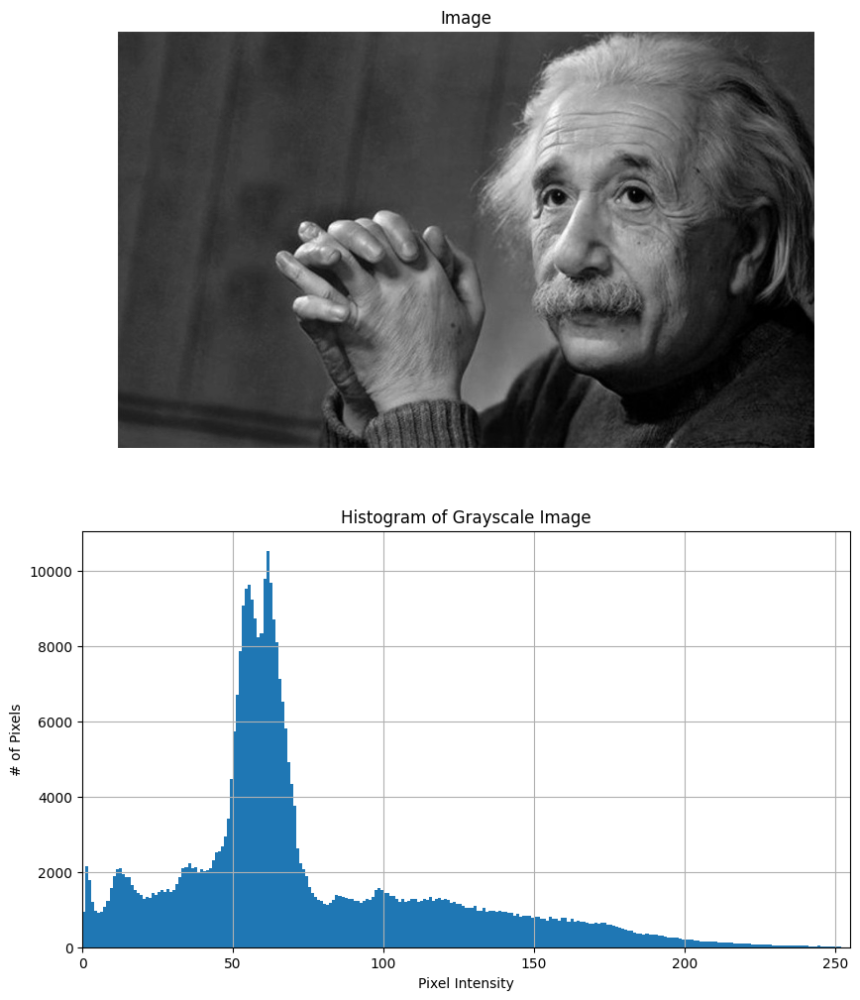

In [127]:
# Histogram of Grayscale Image
plot_histogram(image_gray, title="Histogram of Grayscale Image")

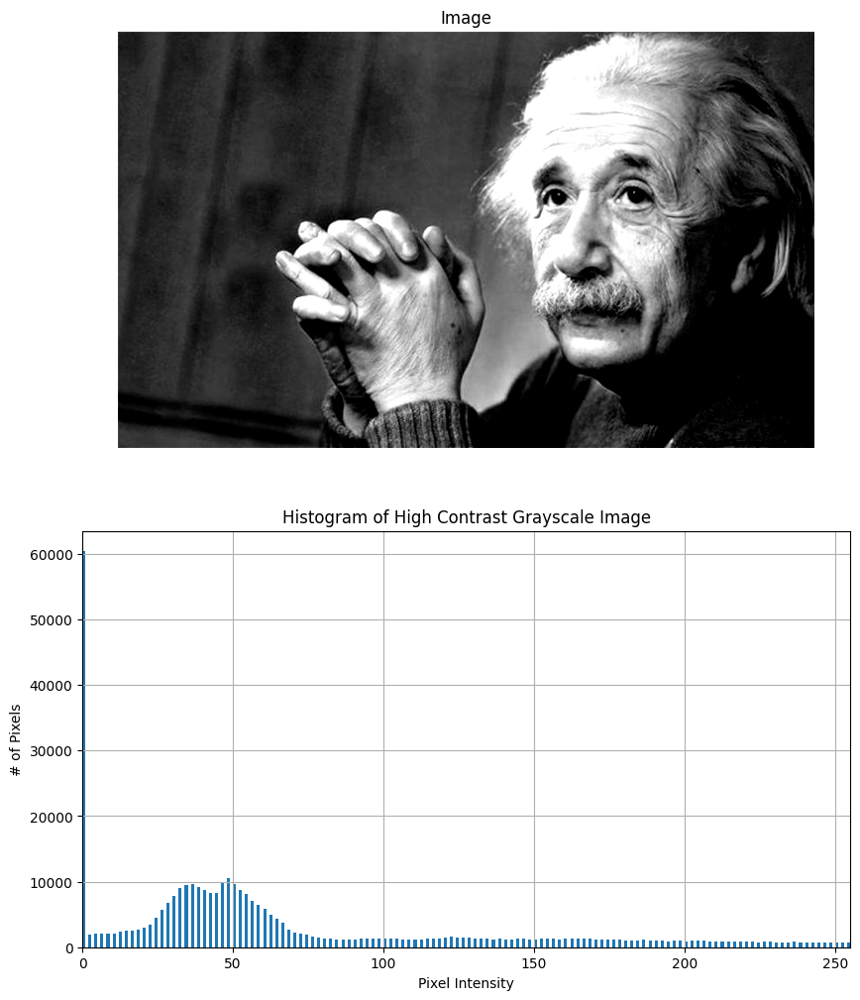

In [128]:
# High contrast grayscale image
image_gray_high_contrast = adjust_contrast(image_gray, 2.0)

# Saving High Contrast Image
cv2.imwrite("Question #1/Einstein_Gray_High_Contrast.jpeg", image_gray_high_contrast)

# Plotting Histogram of High Contrast Image
plot_histogram(image_gray_high_contrast, title="Histogram of High Contrast Grayscale Image")

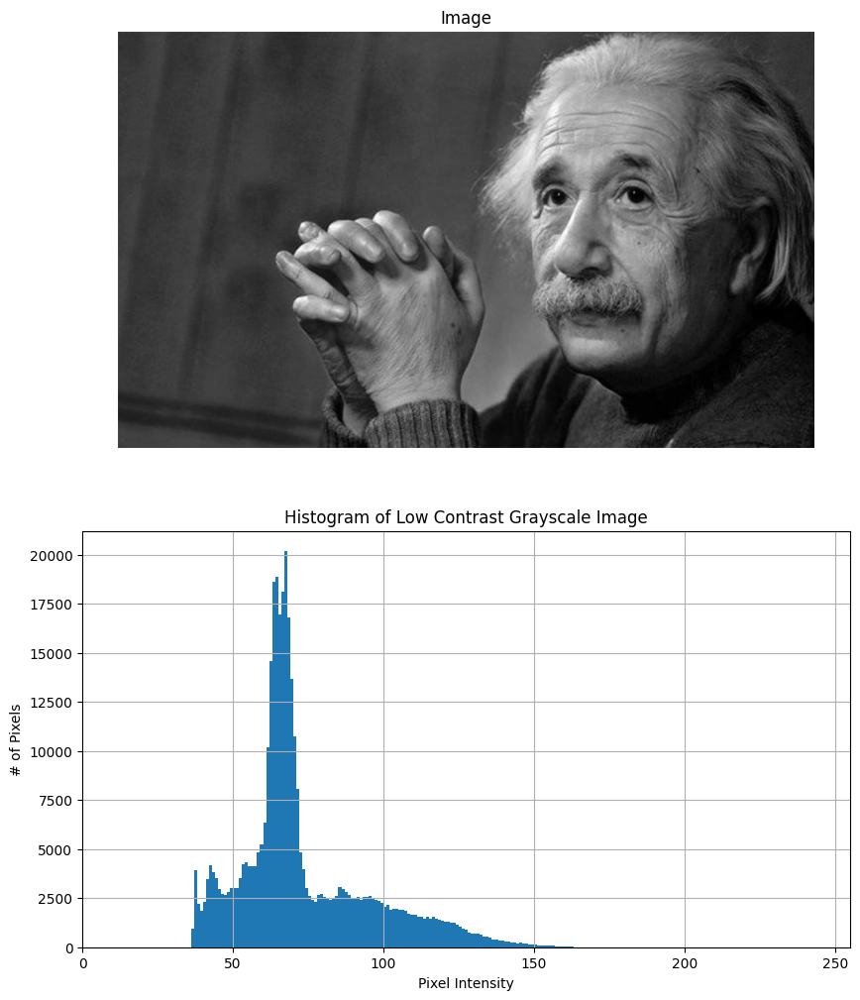

In [129]:
# Low contrast grayscale image
image_gray_low_contrast = adjust_contrast(image_gray, 0.5)

# Saving Low Contrast Image
cv2.imwrite("Question #1/Einstein_Gray_Low_Contrast.jpeg", image_gray_low_contrast)

# Plotting Histogram of Low Contrast Image
plot_histogram(image_gray_low_contrast, title="Histogram of Low Contrast Grayscale Image")

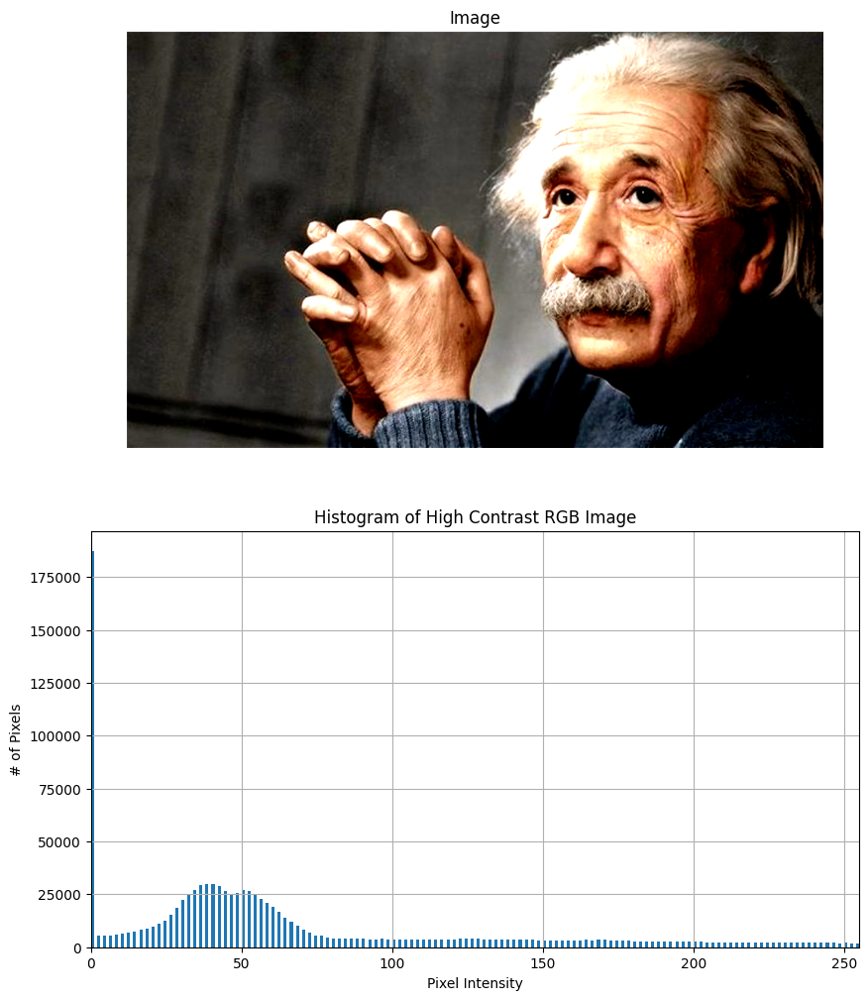

In [130]:
# High contrast RGB image
image_high_contrast = adjust_contrast(image, 2.0)
image_high_contrast = cv2.cvtColor(image_high_contrast, cv2.COLOR_RGB2BGR)

# Saving High Contrast Image
cv2.imwrite("Question #1/Einstein_High_Contrast.jpeg", image_high_contrast)

# Plotting Histogram of High Contrast Image
plot_histogram(cv2.cvtColor(image_high_contrast, cv2.COLOR_BGR2RGB), title="Histogram of High Contrast RGB Image")

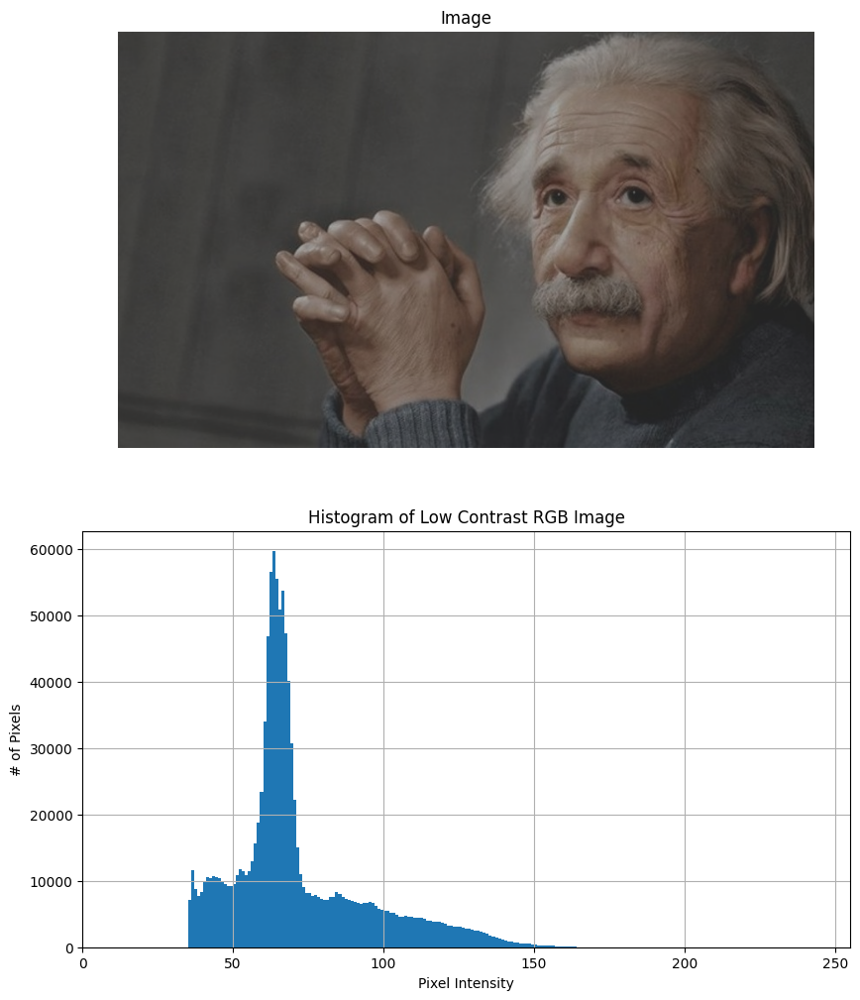

In [131]:
# Low contrast RGB image
image_low_contrast = adjust_contrast(image, 0.5)
image_low_contrast = cv2.cvtColor(image_low_contrast, cv2.COLOR_RGB2BGR)

# Saving Low Contrast Image
cv2.imwrite("Question #1/Einstein_Low_Contrast.jpeg", image_low_contrast)

# Plotting Histogram of Low Contrast Image
plot_histogram(cv2.cvtColor(image_low_contrast, cv2.COLOR_BGR2RGB), title="Histogram of Low Contrast RGB Image")

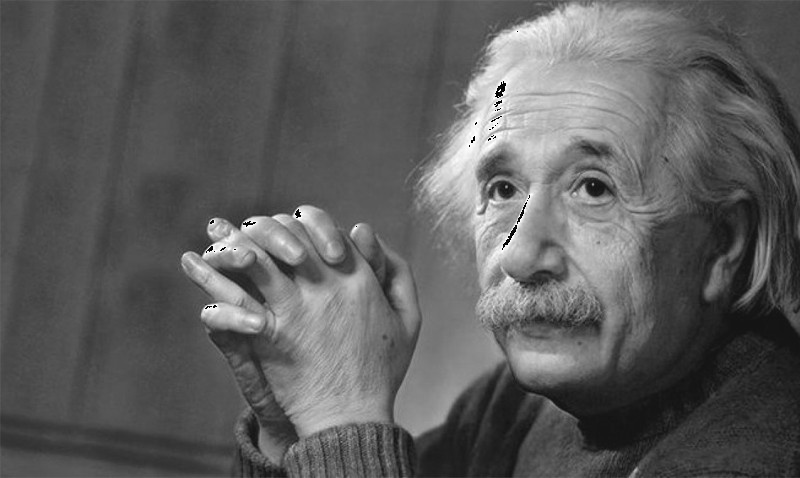

In [132]:
# Adding 20 to the image and clipping between [0, 255]
image_gray_plus_20 = np.clip(image_gray + 20, a_min=0, a_max=255)

# Saving 
cv2.imwrite("Question #1/Einstein_Gray_Plus_20.jpeg", image_gray_plus_20)

# Displying
Image(filename="Question #1/Einstein_Gray_Plus_20.jpeg")

In [133]:
# There is a problem: Overflow!!!
print(type(image_gray_plus_20[0][0]))

<class 'numpy.uint8'>


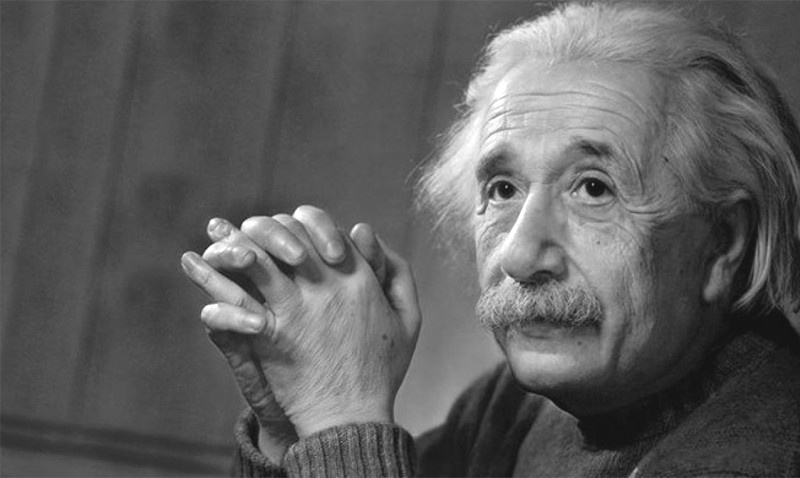

In [134]:
# Casting Image to 16 bit Integer for Pixel Intensity
image_gray_plus_20 = image_gray.astype("uint16")

# Adding 20 to the image and clipping between [0, 255]
image_gray_plus_20 = np.clip(image_gray_plus_20 + 20, a_min=0, a_max=255)

# Saving
cv2.imwrite("Question #1/Einstein_Gray_Plus_20.jpeg", image_gray_plus_20)

# Displaying
Image(filename="Question #1/Einstein_Gray_Plus_20.jpeg")

In [135]:
def add_salt_and_pepper_noise(image, salt_ratio=0.02, pepper_ratio=0.02):
    """
    Adds salt and pepper noise to an image.

    Args:
        image (numpy.ndarray): Input image.
        salt_ratio (float): Ratio of salt noise (default: 0.02).
        pepper_ratio (float): Ratio of pepper noise (default: 0.02).

    Returns:
        numpy.ndarray: Image with salt and pepper noise.
    """
    row, col, _ = image.shape
    salt = np.random.rand(row, col) < salt_ratio
    pepper = np.random.rand(row, col) < pepper_ratio
    noisy_image = np.copy(image)
    noisy_image[salt] = 255
    noisy_image[pepper] = 0
    return noisy_image

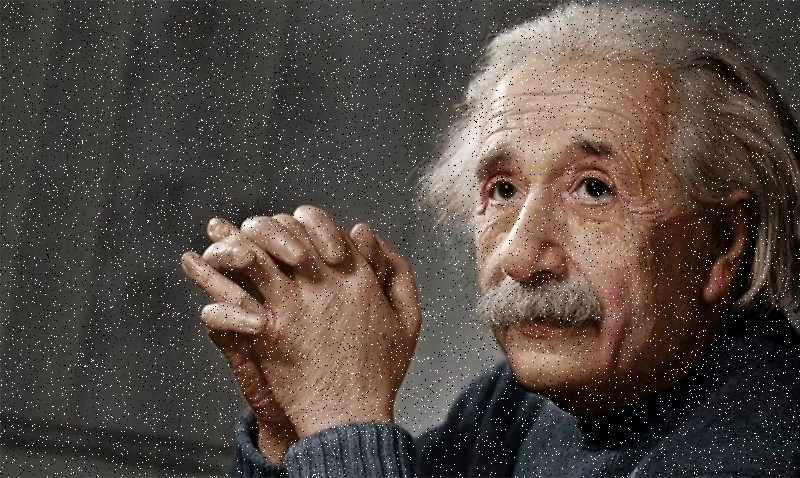

In [136]:
image_gray_salt_pepper = add_salt_and_pepper_noise(image)
image_gray_salt_pepper = cv2.cvtColor(image_gray_salt_pepper, cv2.COLOR_RGB2BGR)
cv2.imwrite("Question #1/Einstein_Salt_Pepper.jpeg", image_gray_salt_pepper)

Image(filename="Question #1/Einstein_Salt_Pepper.jpeg")

###

<font>
<div dir="ltr" align="center">
    <br>
    <font color="green" size="7" style="font-family:Arial, sans-serif;">
        Question #2<br>
    </font>
</div>


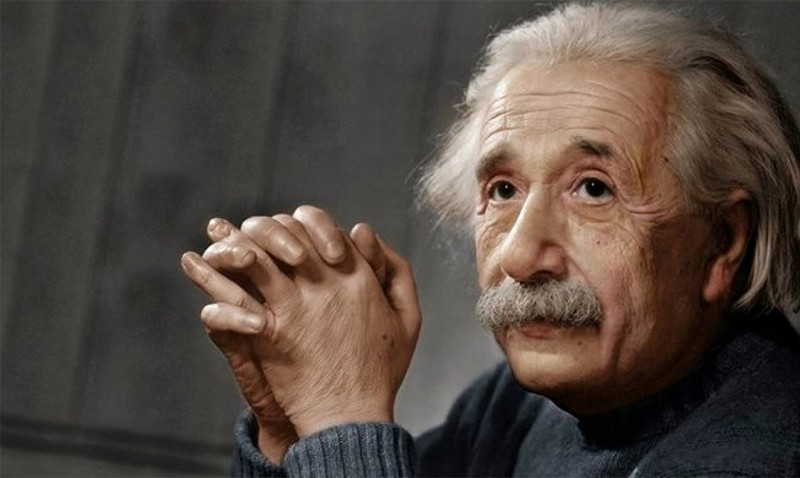

In [137]:
Image(filename="Einstein.jpeg")

### RGB

In [138]:
# Extracting Channels
image_red_channel = image[:, :, 0]
image_green_channel = image[:, :, 1]
image_blue_channel = image[:, :, 2]

In [139]:
# Saving RGB Components
cv2.imwrite("Question #2/RGB/Einstein_Red_Channel.jpeg", image_red_channel)
cv2.imwrite("Question #2/RGB/Einstein_Green_Channel.jpeg", image_green_channel)
cv2.imwrite("Question #2/RGB/Einstein_Blue_Channel.jpeg", image_blue_channel);

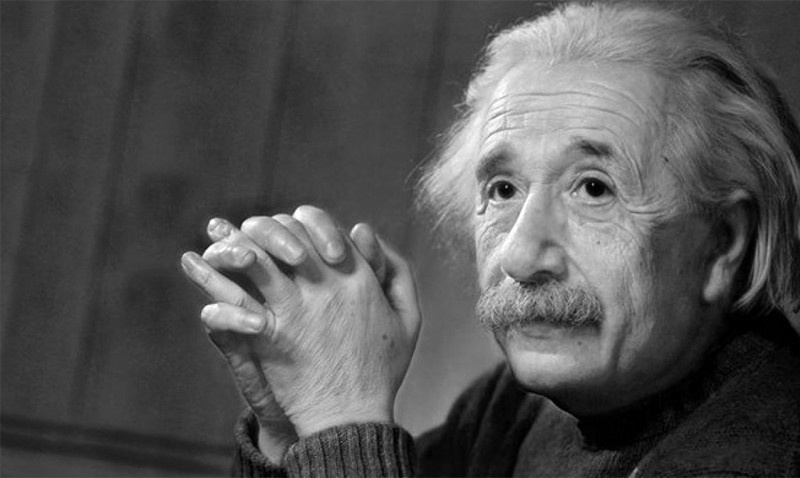

In [140]:
# Displying Red Channel
Image(filename="Question #2/RGB/Einstein_Red_Channel.jpeg")

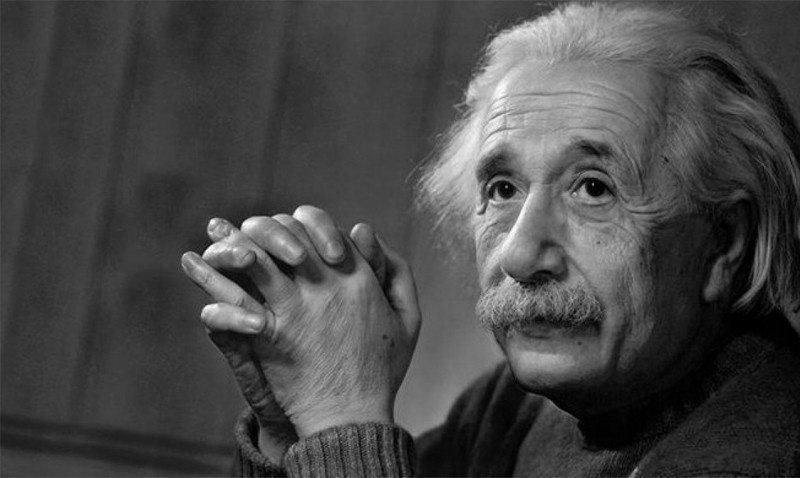

In [72]:
# Displying Green Channel
Image(filename="Question #2/RGB/Einstein_Green_Channel.jpeg")

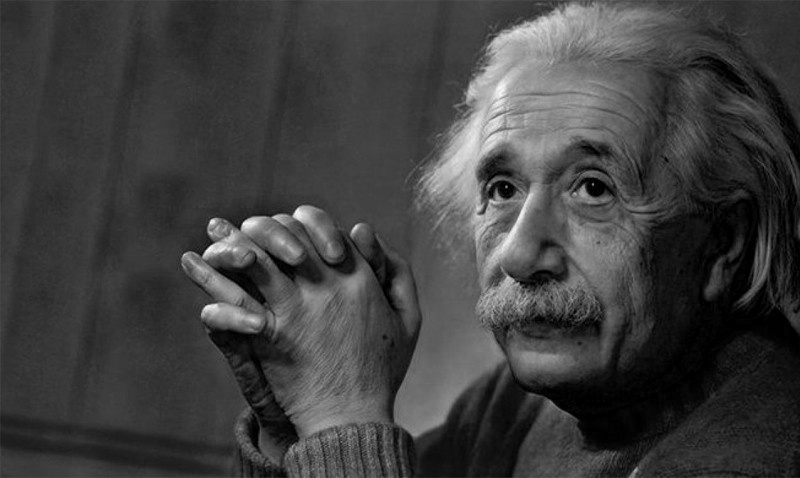

In [73]:
# Displying Blue Channel
Image(filename="Question #2/RGB/Einstein_Blue_Channel.jpeg")

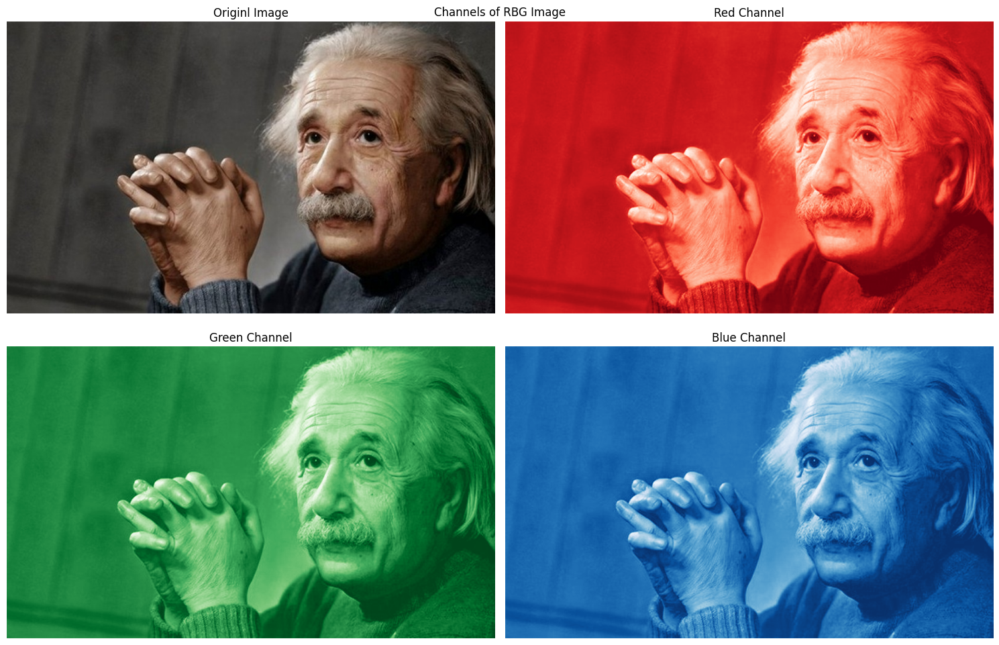

In [74]:
# Representing Channels of RGB Image
plt.figure(figsize=(15, 10))
plt.subplot(2, 2, 1)
plt.imshow(image)
plt.title("Originl Image")
plt.axis("off")

plt.subplot(2, 2, 2)
plt.imshow(image_red_channel, cmap="Reds_r")
plt.title("Red Channel")
plt.axis("off")

plt.subplot(2, 2, 3)
plt.imshow(image_green_channel, cmap="Greens_r")
plt.title("Green Channel")
plt.axis("off")

plt.subplot(2, 2, 4)
plt.imshow(image_blue_channel, cmap="Blues_r")
plt.title("Blue Channel")
plt.axis("off")

plt.tight_layout()
plt.suptitle("Channels of RBG Image")
plt.savefig("Question #2/RGB/Channels.jpeg")
plt.show()

### CMYK

In [75]:
# https://en.wikipedia.org/wiki/CMYK_color_model

def rgb_to_cmyk(rgb_image):
    """
    Convert RGB color to CMYK color.

    Parameters:
    - r, g, b: RGB values (0-255)

    Returns:
    - c, m, y, k: CMYK values (0-1)
    """
    # Convert RGB values to range 0-1
    red = rgb_image[:, :, 0] / 255.0
    green = rgb_image[:, :, 1] / 255.0
    blue = rgb_image[:, :, 2] / 255.0
    image_0_1 = rgb_image / 255.0

    # Calculate Key (Black)
    key = 1 - image_0_1.max(axis=2)  # black

    # Calculate Cyan, Magenta, Yellow
    cyan = (1 - red - key) / (1 - key)
    magenta = (1 - green - key) / (1 - key)
    yellow = (1 - blue - key) / (1 - key)

    # Consider Saturation
    cyan[key == 1] = 0
    magenta[key == 1] = 0
    yellow[key == 1] = 0

    return cyan, magenta, yellow, key

In [76]:
# Converting RGB to CMYK
image_cyan, image_magenta, image_yellow, image_key = rgb_to_cmyk(image)

/tmp/ipykernel_99972/551983022.py:23: RuntimeWarning: invalid value encountered in divide
  cyan = (1 - red - key) / (1 - key)
/tmp/ipykernel_99972/551983022.py:24: RuntimeWarning: invalid value encountered in divide
  magenta = (1 - green - key) / (1 - key)
/tmp/ipykernel_99972/551983022.py:25: RuntimeWarning: invalid value encountered in divide
  yellow = (1 - blue - key) / (1 - key)


In [77]:
cv2.imwrite("Question #2/CMYK/Einstein_Cyan_Channel_CMYK.jpeg", image_cyan)
cv2.imwrite("Question #2/CMYK/Einstein_Magenta_Channel_CMYK.jpeg", image_magenta)
cv2.imwrite("Question #2/CMYK/Einstein_Yellow_Channel_CMYK.jpeg", image_yellow)
cv2.imwrite("Question #2/CMYK/Einstein_Key_Channel_CMYK.jpeg", image_key)

True

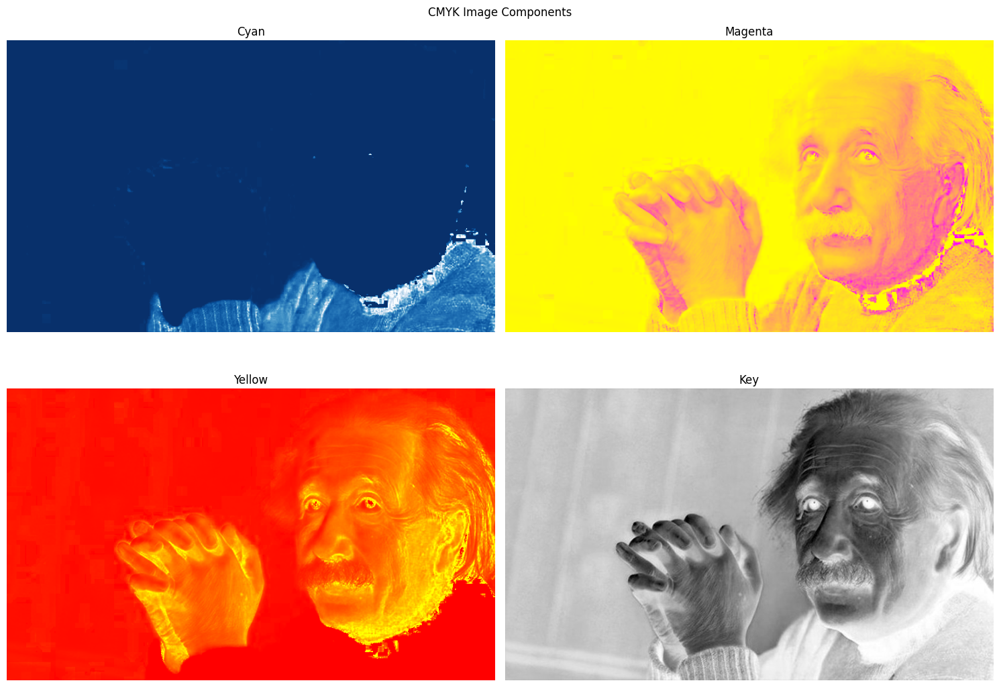

In [82]:
plt.figure(figsize=(15, 11))
plt.subplot(2, 2, 1)
plt.imshow(image_cyan, cmap="Blues_r")
plt.title("Cyan")
plt.axis("off")

plt.subplot(2, 2, 2)
plt.imshow(image_magenta, cmap="spring_r")
plt.title("Magenta")
plt.axis("off")

plt.subplot(2, 2, 3)
plt.imshow(image_yellow, cmap="autumn")
plt.title("Yellow")
plt.axis("off")

plt.subplot(2, 2, 4)
plt.imshow(image_key, cmap="gray")
plt.title("Key")
plt.axis("off")

plt.tight_layout()
plt.suptitle("CMYK Image Components")
plt.savefig("Question #2/CMYK/CMYK Components.jpeg")
plt.show()

### HSV

In [84]:
def rgb_to_hsv(r, g, b):
    """
    Convert RGB values to HSV.
    Input ranges: 0-255 for RGB
    Output ranges: 0-1 for H, S, V
    """
    r, g, b = r / 255.0, g / 255.0, b / 255.0
    max_val = max(r, g, b)
    min_val = min(r, g, b)
    delta = max_val - min_val

    # Calculate Hue
    if delta == 0:
        h = 0
    elif max_val == r:
        h = (60 * ((g - b) / delta) + 360) % 360
    elif max_val == g:
        h = (60 * ((b - r) / delta) + 120) % 360
    elif max_val == b:
        h = (60 * ((r - g) / delta) + 240) % 360

    # Calculate Saturation
    s = 0 if max_val == 0 else (delta / max_val)

    # Calculate Value
    v = max_val

    return h / 360, s, v


def image_rgb_to_hsv(image):
    """
    Convert an image from RGB to HSV color space.
    """
    hsv_image = np.zeros_like(image, dtype=np.float32)
    for i in range(image.shape[0]):
        for j in range(image.shape[1]):
            r, g, b = image[i, j]
            hsv_image[i, j] = rgb_to_hsv(r, g, b)
    return hsv_image

In [86]:
# Convert the image from RGB to HSV
hsv_image = image_rgb_to_hsv(image)
image_hue = hsv_image[:, :, 0]
image_saturation = hsv_image[:, :, 1]
image_value = hsv_image[:, :, 2]

In [87]:
# Saving HSV Components
cv2.imwrite("Question #2/HSV/Einstein_HSV.jpeg", hsv_image)
cv2.imwrite("Question #2/HSV/Einstein_Hue_HSV.jpeg", image_hue)
cv2.imwrite("Question #2/HSV/Einstein_Saturation_HSV.jpeg", image_saturation)
cv2.imwrite("Question #2/HSV/Einstein_Value_HSV.jpeg", image_value)

True

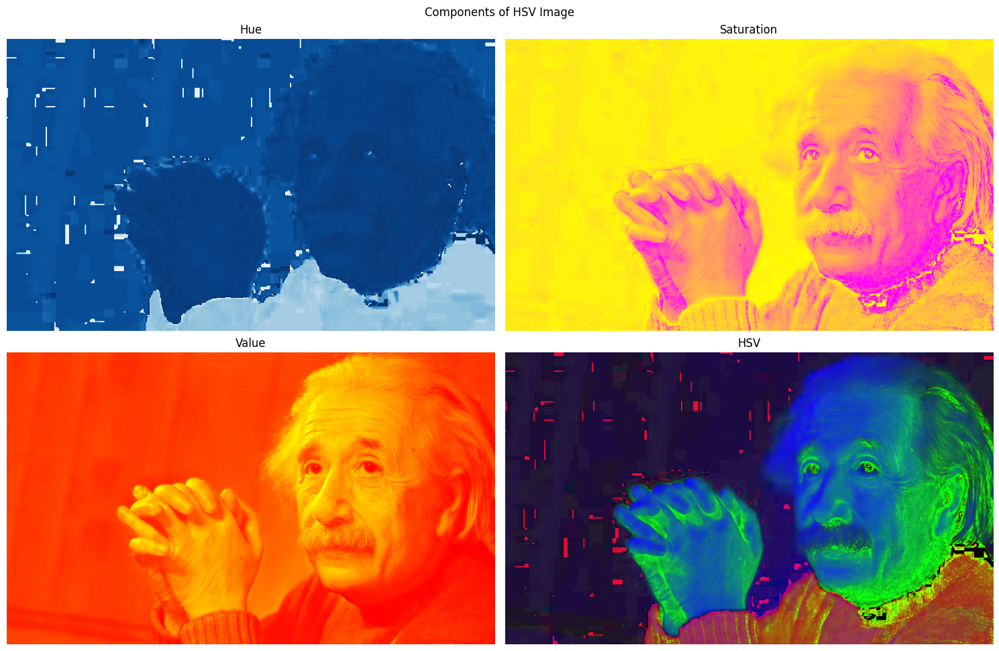

In [88]:
plt.figure(figsize=(15, 10))

plt.subplot(2, 2, 1)
plt.imshow(image_hue, cmap="Blues_r")
plt.title("Hue")
plt.axis("off")

plt.subplot(2, 2, 2)
plt.imshow(image_saturation, cmap="spring_r")
plt.title("Saturation")
plt.axis("off")

plt.subplot(2, 2, 3)
plt.imshow(image_value, cmap="autumn")
plt.title("Value")
plt.axis("off")

plt.subplot(2, 2, 4)
plt.imshow(hsv_image)
plt.title("HSV")
plt.axis("off")

plt.suptitle("Components of HSV Image")
plt.tight_layout()
plt.savefig("Question #2/HSV/Components.jpeg")
plt.show()

#### Histogram

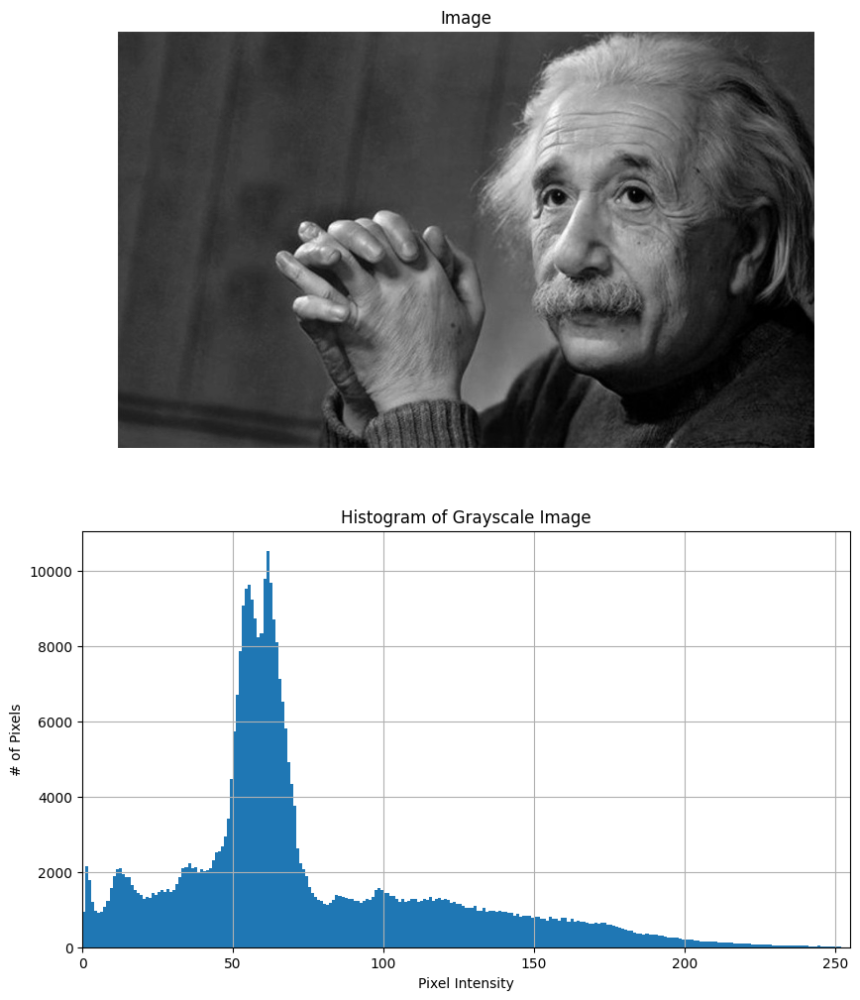

In [141]:
# Histogram of Grayscale Image
plot_histogram(image_gray, "Histogram of Grayscale Image")

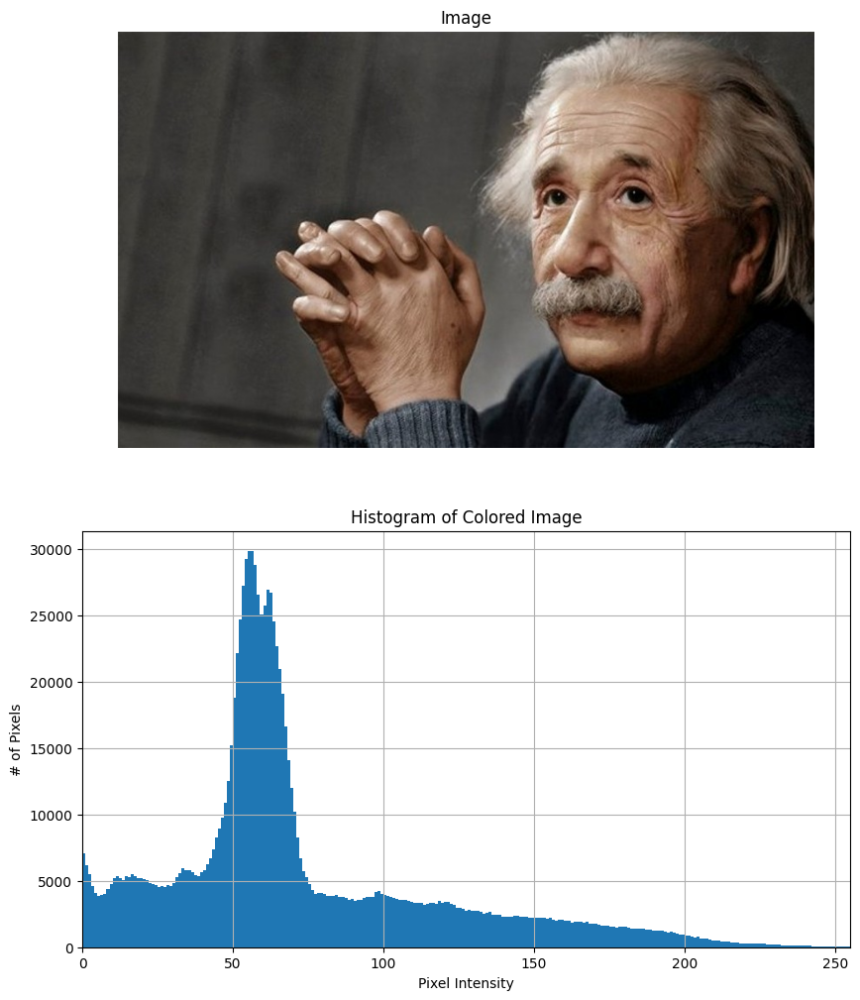

In [142]:
# Histogram of Colored Image
plot_histogram(image, "Histogram of Colored Image")

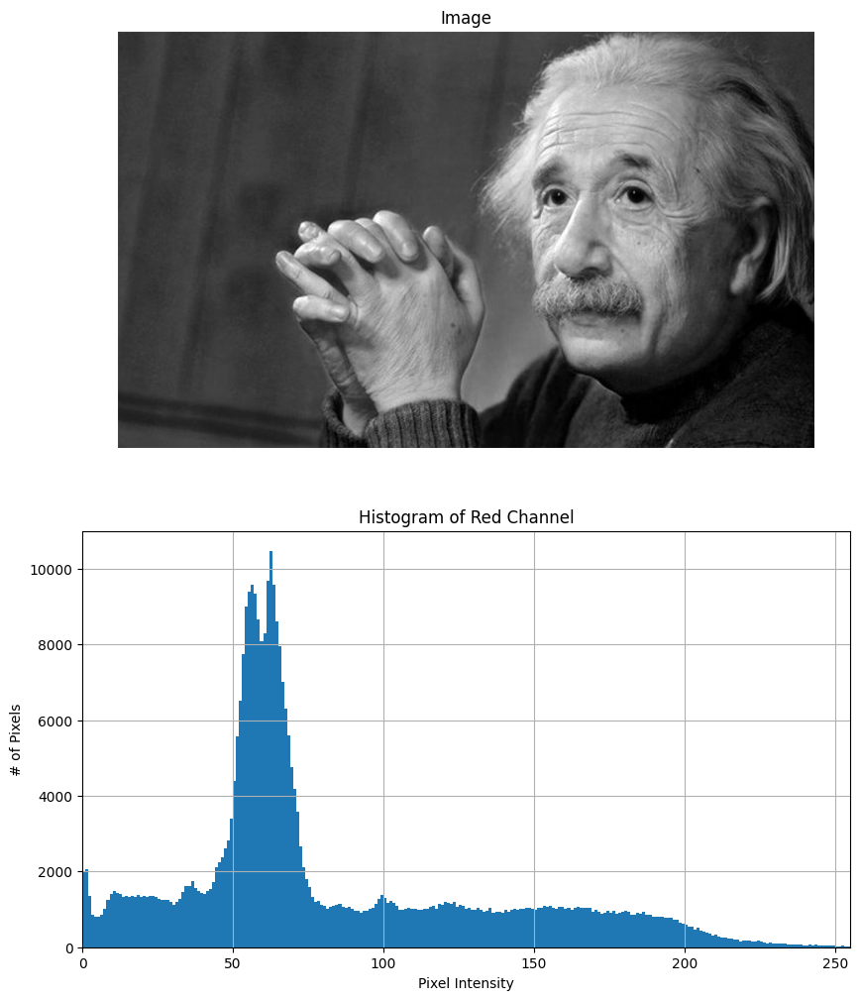

In [143]:
# Histogram of Red Channel
plot_histogram(image_red_channel, "Histogram of Red Channel")

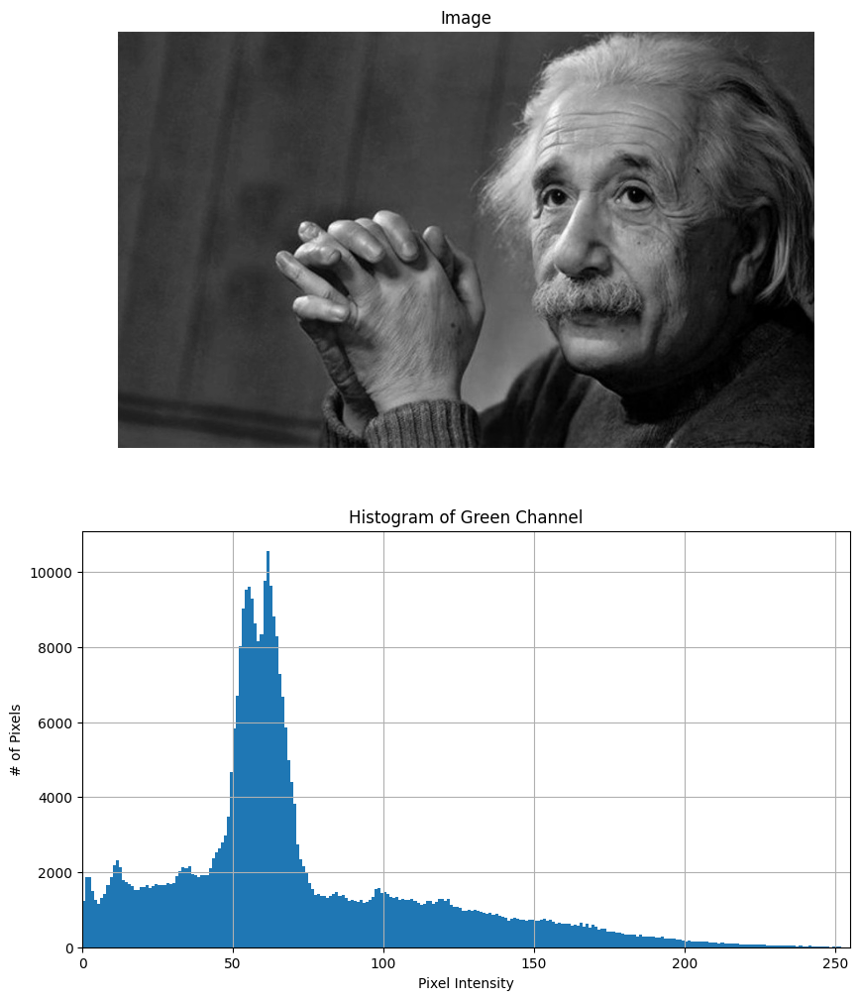

In [144]:
# Histogram of Green Channel
plot_histogram(image_green_channel, "Histogram of Green Channel")

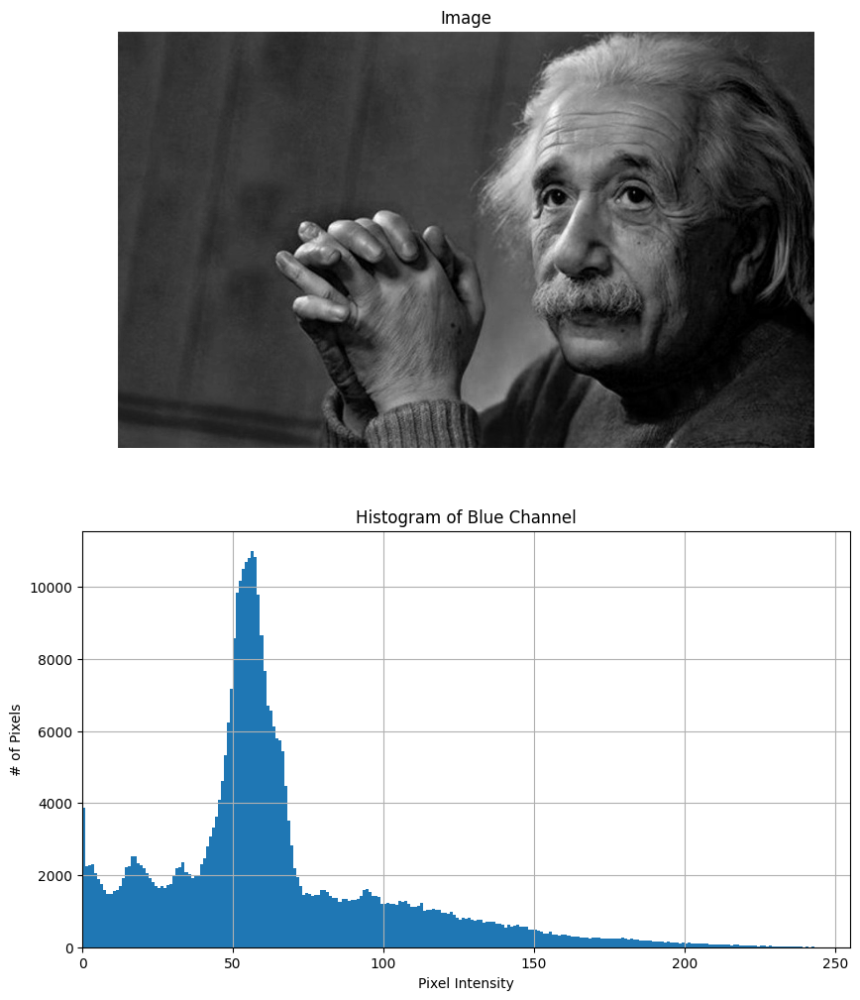

In [145]:
# Histogram of Blue Channel
plot_histogram(image_blue_channel, "Histogram of Blue Channel")

#### Histogram Equalization

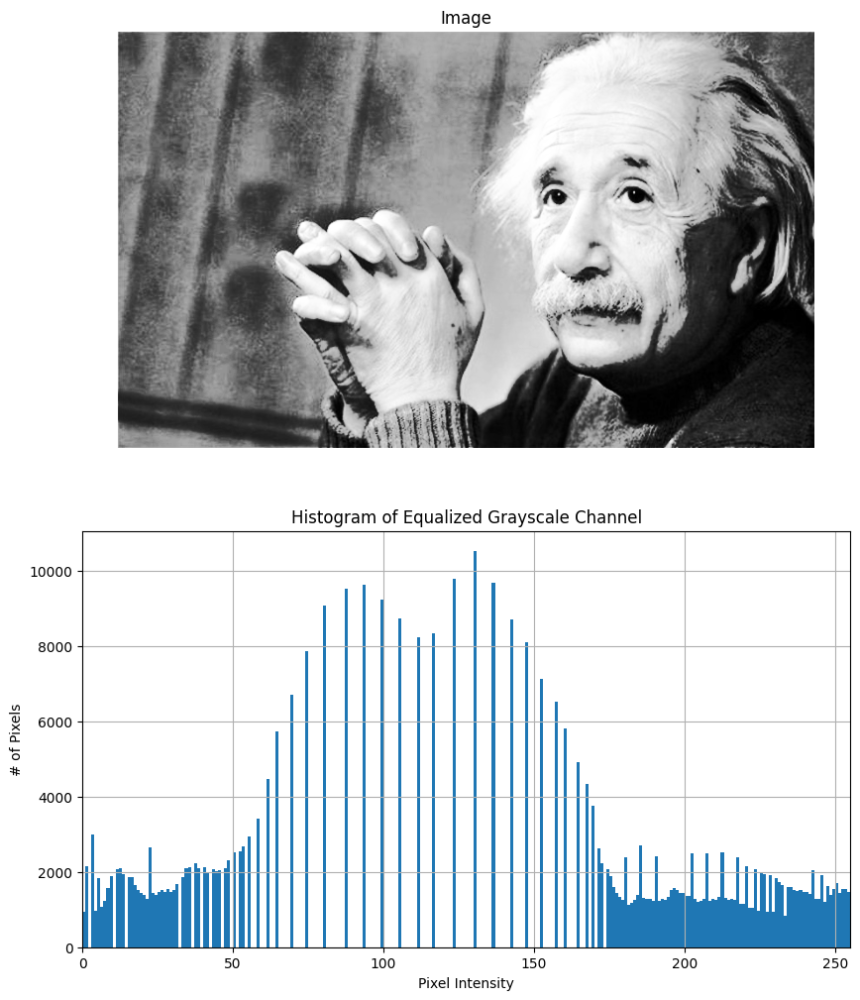

In [146]:
# Histogram Equalization Using OpneCV
image_gray_equalized = cv2.equalizeHist(image_gray)

# Saving
cv2.imwrite("Question #2/Histogram Equalization/Einstein_Gray_Equalized.jpeg", image_gray_equalized)

# Plotting Histogram
plot_histogram(image_gray_equalized, "Histogram of Equalized Grayscale Channel")

In [147]:
def histogram_equalization_gray(image):
    """
    Perform histogram equalization on a grayscale image.

    Parameters:
    - image: Input image as a 2D NumPy array (grayscale).

    Returns:
    - equalized_image: Histogram equalized image as a 2D NumPy array.
    """
    # Compute the histogram of the input image
    hist, bins = np.histogram(image.flatten(), 256, [0, 256])

    # Compute the cumulative distribution function (CDF)
    cdf = hist.cumsum()

    # Create a mask where cdf is 0 (to avoid division by zero)
    cdf_m = np.ma.masked_equal(cdf, 0)

    # Compute the equalization lookup table
    cdf_m = (cdf_m - cdf_m.min()) * 255 / (cdf_m.max() - cdf_m.min())
    cdf = np.ma.filled(cdf_m, 0).astype("uint8")

    # Apply the equalization lookup table to the image
    equalized_image = cdf[image]

    return equalized_image

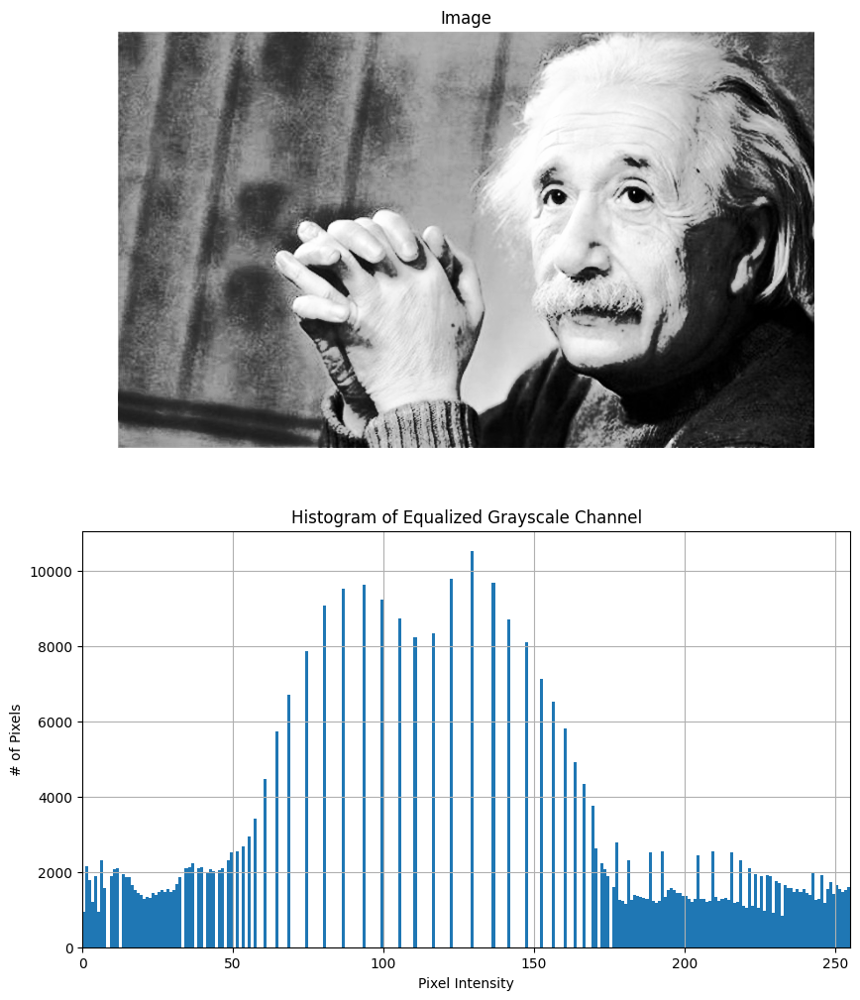

In [148]:
# Histogram Equalization Without Using OpneCV
image_gray_equalized = histogram_equalization_gray(image_gray)

# Saving
cv2.imwrite("Question #2/Histogram Equalization/Einstein_Gray_Equalized.jpeg", image_gray_equalized)

# Plotting Histogram
plot_histogram(image_gray_equalized, "Histogram of Equalized Grayscale Channel")

In [149]:
# Histogram equlization for RGB images
def histogram_equalization_rgb(image_rgb: np.ndarray):
    red = image_rgb[:, :, 0]
    green = image_rgb[:, :, 1]
    blue = image_rgb[:, :, 2]

    image_red_channel_equalized = cv2.equalizeHist(red)
    image_green_channel_equalized = cv2.equalizeHist(green)
    image_blue_channel_equalized = cv2.equalizeHist(blue)

    image_equalized = np.stack(
        (
            image_red_channel_equalized,
            image_green_channel_equalized,
            image_blue_channel_equalized,
        ),
        axis=2,
    )

    return image_equalized

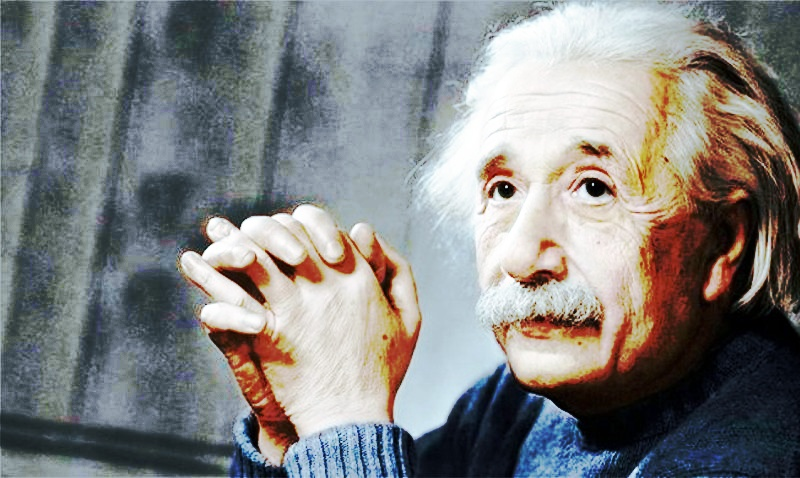

In [150]:
image_equalized = histogram_equalization_rgb(image)
image_equalized = cv2.cvtColor(image_equalized, cv2.COLOR_RGB2BGR)

# Saving
cv2.imwrite("Question #2/Histogram Equalization/Einstein_Equalized_RGB.jpeg", image_equalized)

# Plotting Histogram
Image("Question #2/Histogram Equalization/Einstein_Equalized_RGB.jpeg")

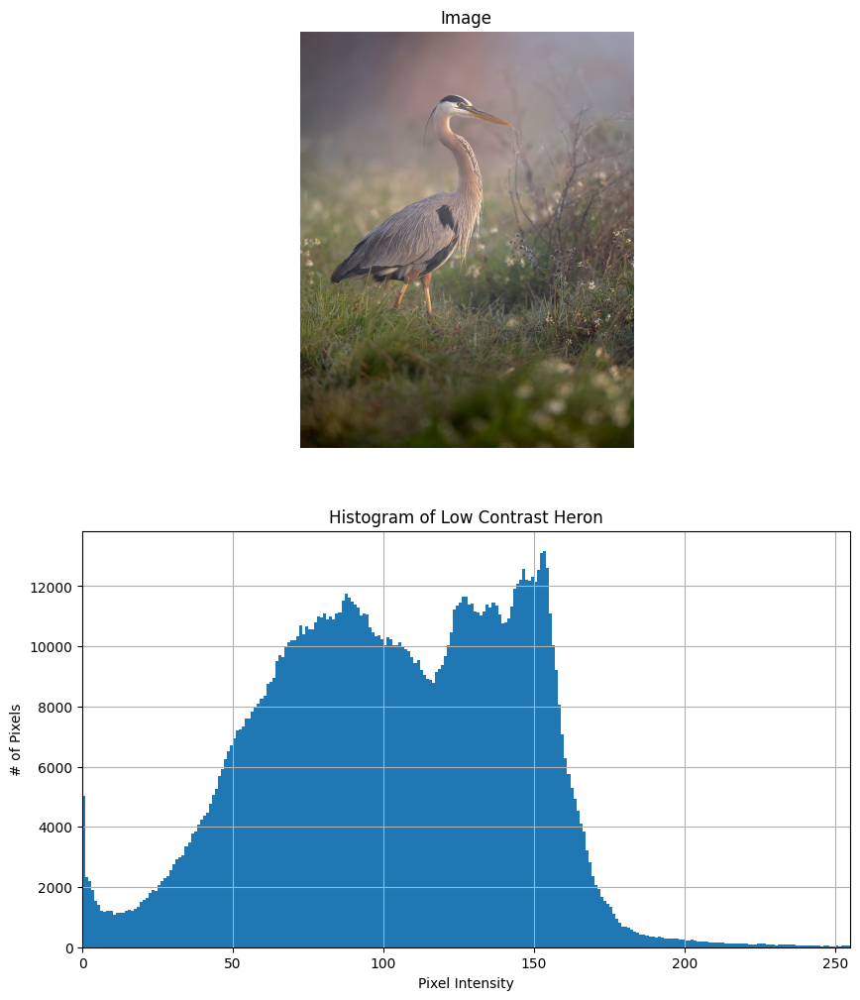

In [154]:
# Image Source: https://backcountrygallery.com/af-help-for-tricky-low-contrast-subjects/

# Loading Low Contrast Image
heron = cv2.imread("heron.jpg")
heron = cv2.cvtColor(heron, cv2.COLOR_BGR2RGB)

# Plotting Histogram
plot_histogram(heron, "Histogram of Low Contrast Heron")

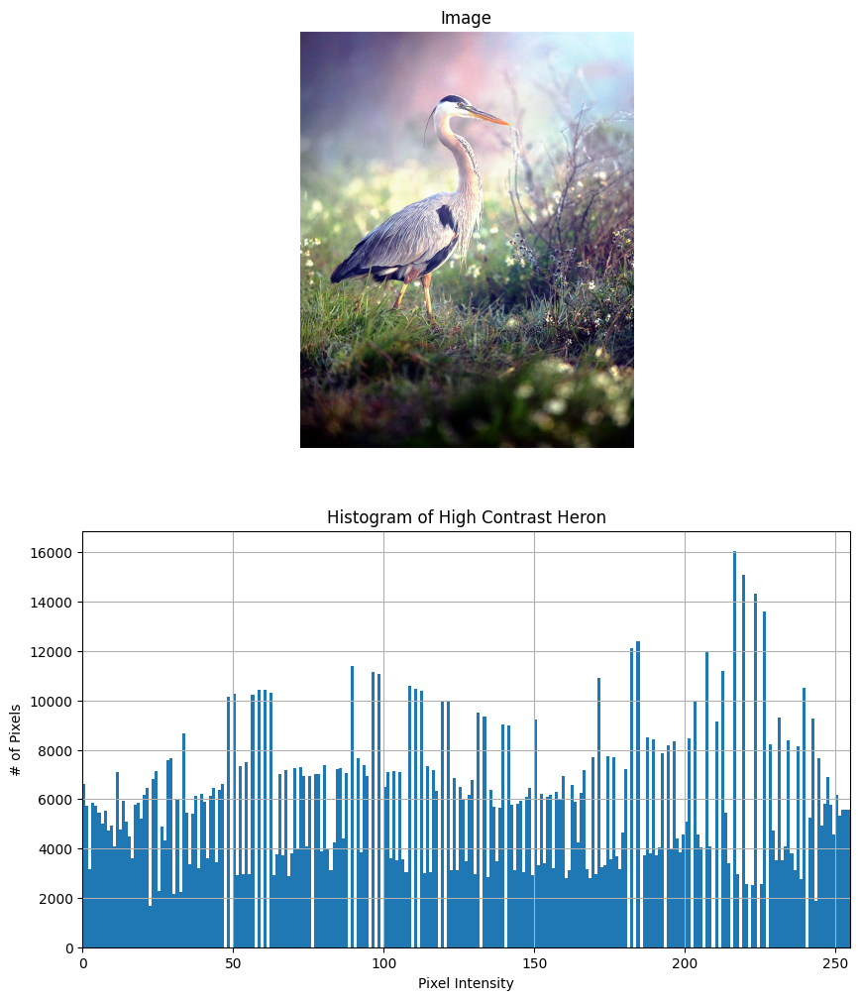

True

In [204]:
# Histogram Equalization
heron_equalized = histogram_equalization_rgb(heron)

# Plotting Histogram
plot_histogram(heron_equalized, "Histogram of High Contrast Heron")

# Saving
heron_equalized = cv2.cvtColor(heron_equalized, cv2.COLOR_RGB2BGR)
cv2.imwrite("Question #2/Histogram Equalization/heron_equalized.jpg", heron_equalized)

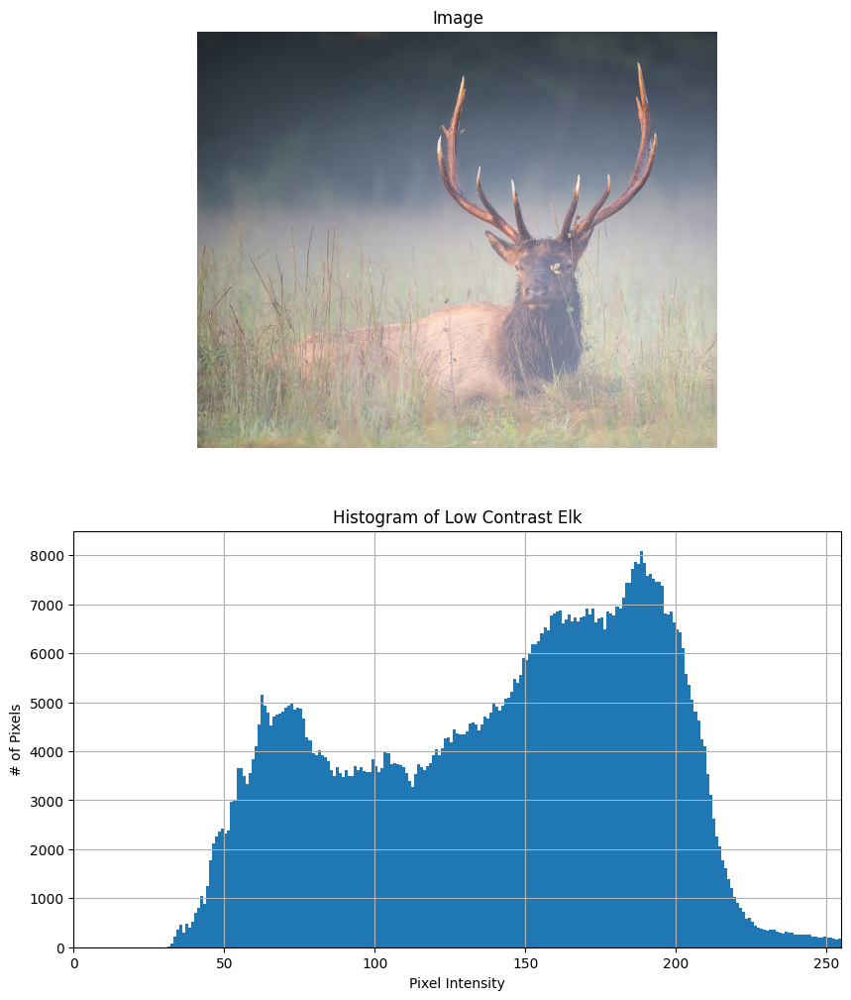

In [157]:
# Image Source: https://backcountrygallery.com/af-help-for-tricky-low-contrast-subjects/

# Loading Low Contrast Image
elk = cv2.imread("elk.jpg")
elk = cv2.cvtColor(elk, cv2.COLOR_BGR2RGB)

# Plotting Histogram
plot_histogram(elk, "Histogram of Low Contrast Elk")

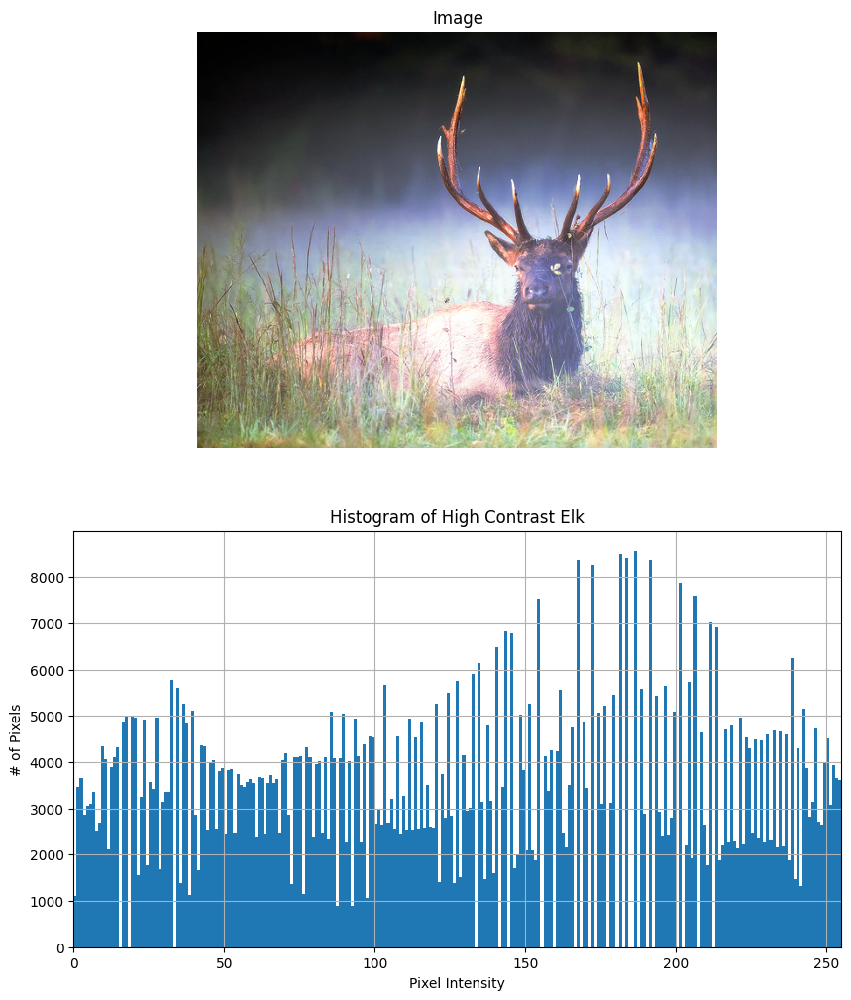

True

In [205]:
# Histogram Equalization
elk_equalized = histogram_equalization_rgb(elk)

# Plotting Histogram
plot_histogram(elk_equalized, "Histogram of High Contrast Elk")

# Saving
elk_equalized = cv2.cvtColor(elk_equalized, cv2.COLOR_RGB2BGR)
cv2.imwrite("Question #2/Histogram Equalization/elk_equalized.jpg", elk_equalized)

#### Fourier Transform

In [159]:
def fourier_transform(image):
    """
    Perform Fourier Transform on an image and display it.
    """

    # Compute the 2D Fourier Transform
    f_transform = np.fft.fft2(image)
    f_transform_shifted = np.fft.fftshift(f_transform)

    # Compute the magnitude spectrum (log scale)
    magnitude_spectrum = 20 * np.log(np.abs(f_transform_shifted))

    # Plot the original image and its magnitude spectrum
    plt.figure(figsize=(18, 12))

    plt.subplot(2, 1, 1)
    plt.title("Original Image")
    plt.imshow(image, cmap="gray")
    plt.axis("off")

    plt.subplot(2, 1, 2)
    plt.title("Fourier Transform (Magnitude Spectrum)")
    plt.imshow(magnitude_spectrum, cmap="gray")
    plt.axis("off")

    plt.show()

In [162]:
def fourier_transform(image, title, address=None):
    """
    Perform Fourier Transform on an image and display it.
    """

    # Compute the 2D Fourier Transform
    f_transform = np.fft.fft2(image)
    f_transform_shifted = np.fft.fftshift(f_transform)

    # Compute the magnitude spectrum (log scale)
    magnitude_spectrum = 20 * np.log(np.abs(f_transform_shifted))

    # Plot the original image and its magnitude spectrum
    plt.figure(figsize=(18, 5))

    plt.subplot(1, 2, 1)
    plt.title("Original Image")
    plt.imshow(image, cmap="gray")
    plt.axis("off")

    plt.subplot(1, 2, 2)
    plt.title("Fourier Transform (Magnitude Spectrum)")
    plt.imshow(magnitude_spectrum, cmap="gray")
    plt.axis("off")

    plt.suptitle(title)
    plt.tight_layout()
    if address is not None:
        plt.savefig(address)
    plt.show()

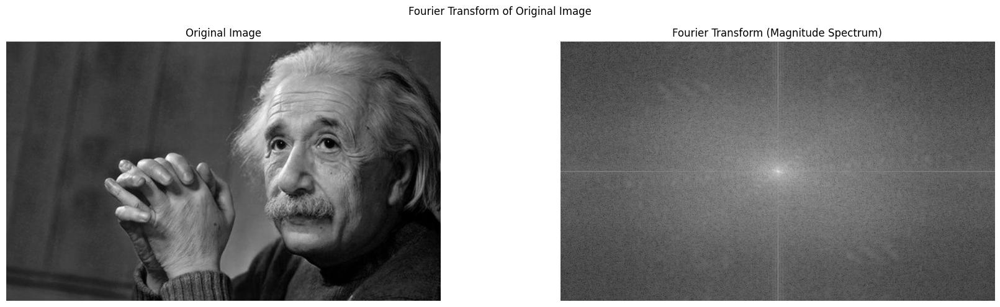

In [163]:
fourier_transform(
    image_gray,
    "Fourier Transform of Original Image",
    "Question #2/Fourier Transform/Fourier Transform of Original Image.jpeg",
)

Interpreting the Fourier Transform of an image can provide insights into its frequency content. Here’s a step-by-step guide:

1. Frequency Domain Representation: The Fourier Transform decomposes an image into its sine and cosine components, which represent different frequency signals. The result is a complex-valued image where each pixel represents a frequency component.

2. Magnitude Spectrum: This is typically what's visualized. Bright spots in the magnitude spectrum indicate the presence of strong frequency components in the image:

* Center: Represents the low-frequency components (overall intensity).

* Edges: Represent high-frequency components (details and sharp transitions).

3. Symmetry: The Fourier Transform of a real-valued image is symmetric. This symmetry can be used to validate the transform:

* Horizontal and Vertical Symmetry: Indicates consistent, predictable features in the image.

* Asymmetry: Might indicate directional features like lines or edges.

Practical Examples:
* Low-Frequency Dominance: If the magnitude spectrum has bright spots mostly at the center, the image contains smooth regions or gradual intensity changes.

* High-Frequency Dominance: If the bright spots are towards the edges, the image has many sharp edges or noise.

Example Visualization:
If you performed a Fourier Transform on an image and visualized the magnitude spectrum, you might see something like this:

* A central bright spot indicates a strong overall intensity (low frequency).

* Bright spots away from the center suggest edges or fine details in specific directions.

Noise Reduction:
* By manipulating the frequency domain (e.g., filtering out high frequencies), you can reduce noise or blur the image.

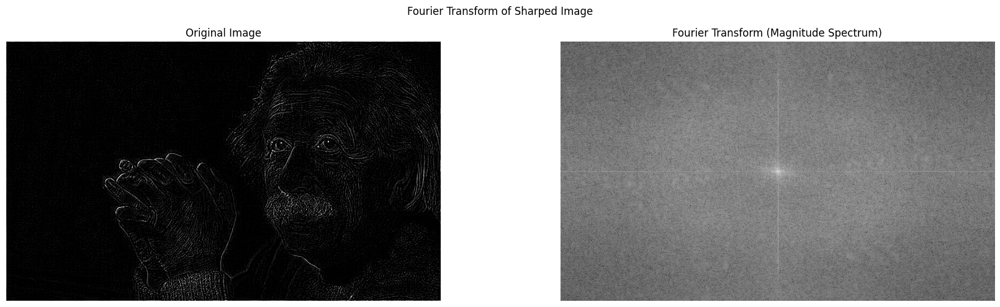

In [167]:
# Defining Sharpening Kernel
high_pass_kernel = np.array([[-1, -1, -1], [-1, 8, -1], [-1, -1, -1]])

# Applying Sharpening Kernel on Image
image_high_freq = cv2.filter2D(image_gray, -1, high_pass_kernel)

# Fourier Transform
fourier_transform(
    image_high_freq,
    "Fourier Transform of Sharped Image",
    "Question #2/Fourier Transform/Fourier Transform of Sharped Image.jpeg",
)

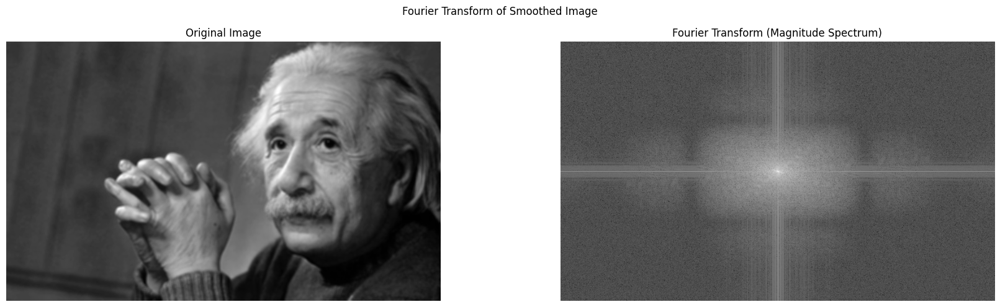

In [ ]:
# Defining Average Blur Kernel
x = 5
low_pass_kernel = np.ones((x, x), np.float32) / x**2

# Applying Average Blur Kernel on Image
image_low_freq = cv2.filter2D(image_gray, -1, low_pass_kernel)

# Fourier Transform
fourier_transform(
    image_low_freq,
    "Fourier Transform of Smoothed Image",
    "Question #2/Fourier Transform/Fourier Transform of Smoothed Image.jpeg",
)

### 

<font>
<div dir="ltr" align="center">
    <br>
    <font color="green" size="7" style="font-family:Arial, sans-serif;">
        Question #3<br>
    </font>
</div>


In [1418]:
from PIL import Image

# Load image
image_path = "Einstein.jpeg"
image = Image.open(image_path)

# Get image format and resolution
print(f"Format: {image.format}")
print(f"Resolution: {image.size}")

# Display image information
image.show()

# Display image header and bit stream (simulated example)
header_info = {"Width": image.width, "Height": image.height, "Color Space": image.mode}
print("Header Information:", header_info)

# Assuming we have extracted the bit stream
# Here, we just simulate the bit stream info
bit_stream_info = np.array(image).flatten()[
    :100
]  # Simulate bit stream by taking first 100 pixel values
print("Bit Stream (first 100 values):", bit_stream_info)

Format: JPEG
Resolution: (800, 478)
Header Information: {'Width': 800, 'Height': 478, 'Color Space': 'RGB'}
Bit Stream (first 100 values): [66 65 61 57 56 52 61 60 56 63 62 58 64 63 59 65 64 60 62 61 57 62 61 57
 63 62 58 63 62 58 63 62 58 64 63 59 65 64 60 64 63 59 63 62 58 62 61 57
 57 56 52 58 57 53 59 58 54 60 59 55 61 60 56 61 60 56 60 59 55 60 59 55
 62 61 57 63 62 58 63 62 58 64 63 59 65 64 60 67 66 62 69 68 64 71 70 66
 69 68 64 69]


/snap/core20/current/lib/x86_64-linux-gnu/libstdc++.so.6: version `GLIBCXX_3.4.29' not found (required by /lib/x86_64-linux-gnu/libproxy.so.1)
Failed to load module: /home/amir/snap/code/common/.cache/gio-modules/libgiolibproxy.so
eog: symbol lookup error: /snap/core20/current/lib/x86_64-linux-gnu/libpthread.so.0: undefined symbol: __libc_pthread_init, version GLIBC_PRIVATE


###

<font>
<div dir="ltr" align="center">
    <br>
    <font color="green" size="7" style="font-family:Arial, sans-serif;">
        Question #4<br>
    </font>
</div>


In [170]:
# AI Generated Pictures from: https://www.dzine.ai/
# Loading Images
image_1 = cv2.imread("Question #4/Image 1.png")
image_1 = cv2.cvtColor(image_1, cv2.COLOR_BGR2RGB)
image_2 = cv2.imread("Question #4/Image 2.png")
image_2 = cv2.cvtColor(image_2, cv2.COLOR_BGR2RGB)
image_3 = cv2.imread("Question #4/Image 3.png")
image_3 = cv2.cvtColor(image_3, cv2.COLOR_BGR2RGB)
image_4 = cv2.imread("Question #4/Image 4.png")
image_4 = cv2.cvtColor(image_4, cv2.COLOR_BGR2RGB)

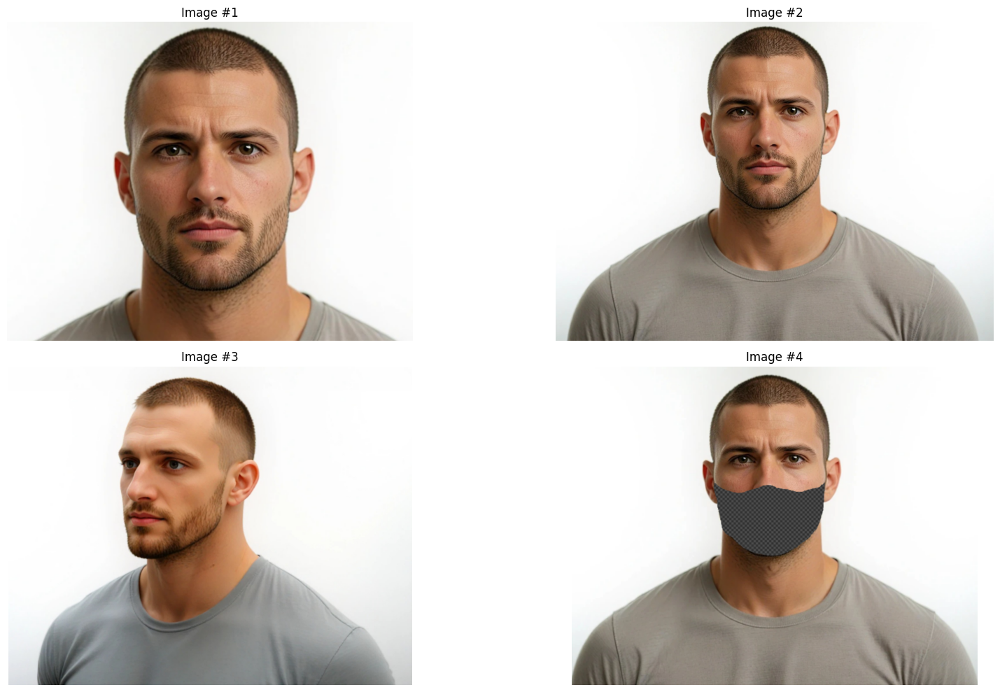

In [ ]:
# Visualizing Images
plt.figure(figsize=(18, 10))

plt.subplot(2, 2, 1)
plt.imshow(image_1)
plt.title("Image #1")
plt.axis("off")

plt.subplot(2, 2, 2)
plt.imshow(image_2)
plt.title("Image #2")
plt.axis("off")

plt.subplot(2, 2, 3)
plt.imshow(image_3)
plt.title("Image #3")
plt.axis("off")

plt.subplot(2, 2, 4)
plt.imshow(image_4)
plt.title("Image #4")
plt.axis("off")

plt.tight_layout()
plt.savefig("Question #4/Images.jpeg")
plt.show()

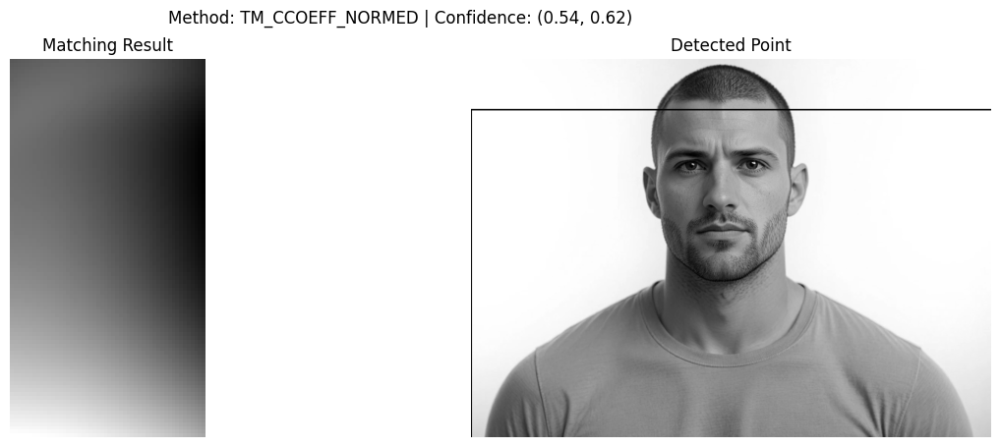

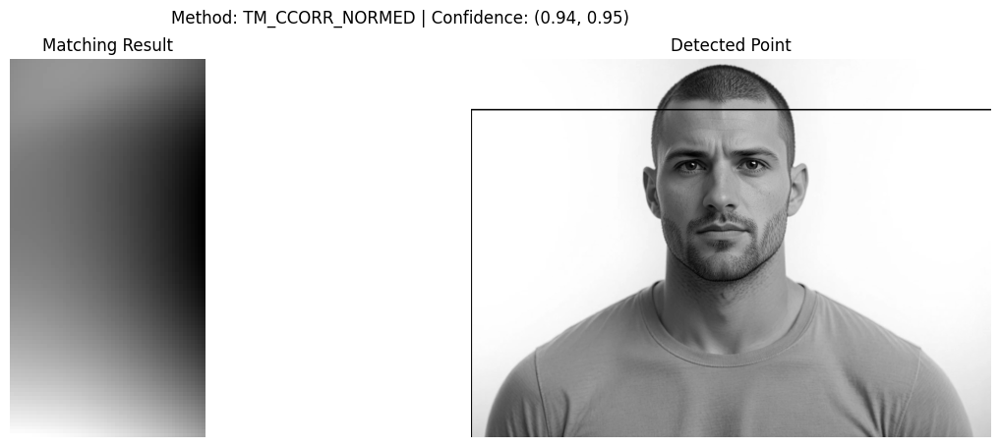

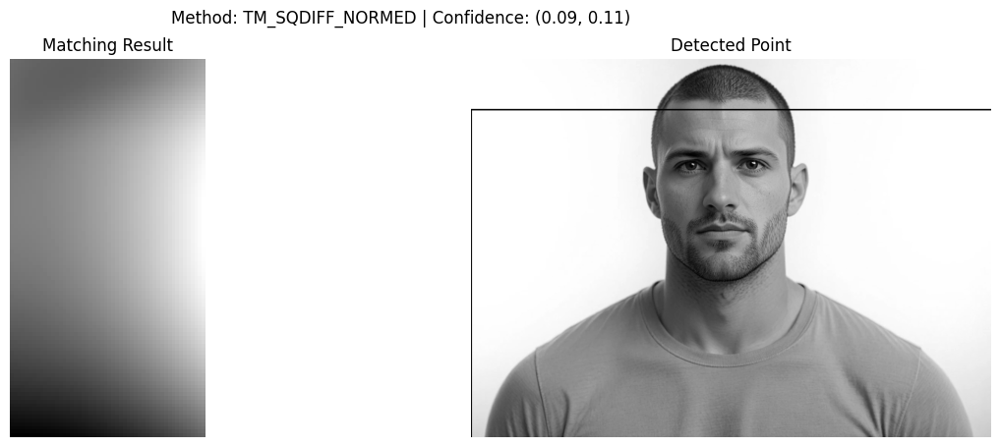

In [174]:
# https://docs.opencv.org/4.x/d4/dc6/tutorial_py_template_matching.html#:~:text=OpenCV%20comes%20with%20a%20function,methods%20are%20implemented%20in%20OpenCV.
# Template Matching is a method for searching and finding the location of a template image in a larger image
img = cv2.imread("Question #4/Image 2.png", cv2.IMREAD_GRAYSCALE)
img2 = img.copy()
template = cv2.imread("Question #4/Image 1.png", cv2.IMREAD_GRAYSCALE)
w, h = template.shape[::-1]

# All the 6 methods for comparison in a list
methods = [
    "TM_CCOEFF_NORMED",
    "TM_CCORR_NORMED",
    "TM_SQDIFF_NORMED",
]

for meth in methods:
    img = img2.copy()
    method = getattr(cv2, meth)

    # Apply template Matching
    res = cv2.matchTemplate(img, template, method)
    min_val, max_val, min_loc, max_loc = cv2.minMaxLoc(res)

    # If the method is TM_SQDIFF or TM_SQDIFF_NORMED, take minimum
    if method in [cv2.TM_SQDIFF, cv2.TM_SQDIFF_NORMED]:
        top_left = min_loc
    else:
        top_left = max_loc
    bottom_right = ((top_left[0] + w), top_left[1] + h)

    cv2.rectangle(img, top_left, bottom_right, 0, 2)

    plt.figure(figsize=(15, 5))
    plt.subplot(121), plt.imshow(res, cmap="gray")
    plt.title("Matching Result")
    plt.axis("off")

    plt.subplot(122), plt.imshow(img, cmap="gray")
    plt.title("Detected Point")
    plt.axis("off")

    plt.suptitle(
        "Method: " + meth + " | Confidence: ({:.2f}, {:.2f})".format(min_val, max_val)
    )
    plt.savefig("Question #4/{}.jpeg".format(meth))
    plt.show()

###
<font>
<div dir="ltr" align="center">
    <br>
    <font color="green" size="7" style="font-family:Arial, sans-serif;">
        Question #5<br>
    </font>
</div>


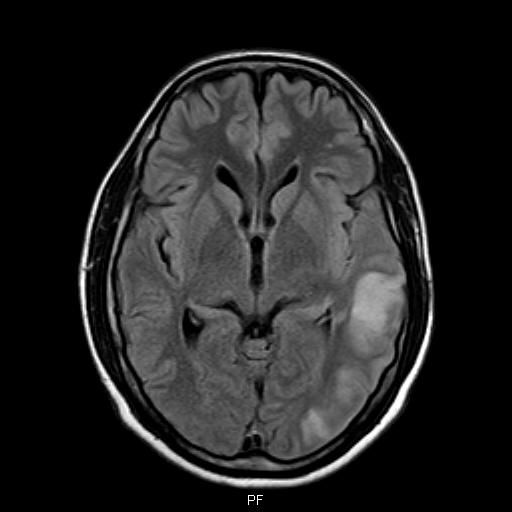

In [188]:
Image("Question #5/MRI/1.jpeg")

### What is the Idea?

In [189]:
# Positioning Brain in the Image
def brain_position(gray_image: np.ndarray):
    gray_image = gray_image.copy()
    vertical_limit_left, vertical_limit_right = 0, 0
    horizental_limit_upper, horizental_limit_lower = 0, 0

    for index, item in enumerate(gray_image.sum(axis=0)):
        if item == 0:
            vertical_limit_left = index
        else:
            break

    for index, item in enumerate(gray_image.sum(axis=0)[::-1]):
        if item == 0:
            vertical_limit_right = index
        else:
            break

    for index, item in enumerate(gray_image.sum(axis=1)):
        if item == 0:
            horizental_limit_upper = index
        else:
            break

    for index, item in enumerate(gray_image.sum(axis=1)[::-1]):
        if item == 0:
            horizental_limit_lower = index
        else:
            break

    return (
        horizental_limit_upper + 2,
        horizental_limit_lower + 2,
        vertical_limit_left + 2,
        vertical_limit_right + 2,
    )

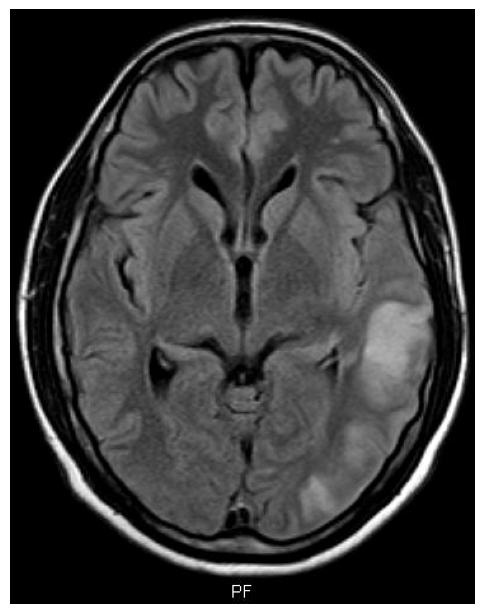

In [190]:
# Loadin Sample MRI Image
MRI_1 = cv2.imread("Question #5/MRI/1.jpeg")
MRI_1 = cv2.cvtColor(MRI_1, cv2.COLOR_RGB2GRAY)

# Positioning
(
    horizental_limit_upper,
    horizental_limit_lower,
    vertical_limit_left,
    vertical_limit_right,
) = brain_position(MRI_1)

MRI_1 = MRI_1[
    horizental_limit_upper:-horizental_limit_lower,
    vertical_limit_left:-vertical_limit_right,
]

# Displaying Positioned MRI Image
plt.figure(figsize=(6, 8))
plt.imshow(MRI_1, cmap="gray")
plt.axis("off")
plt.show()

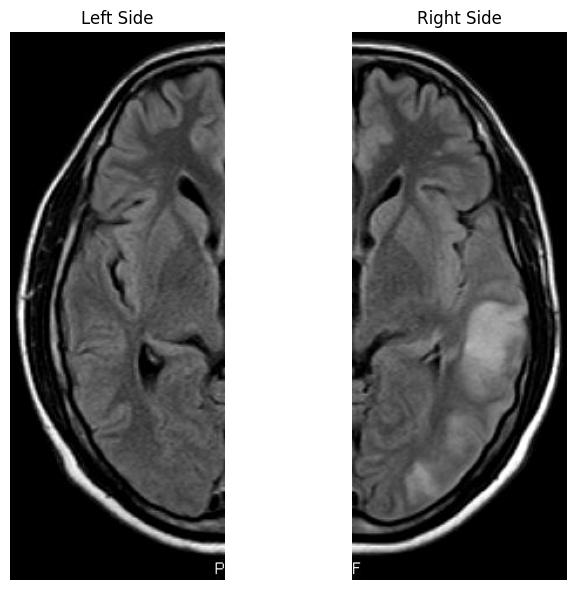

In [191]:
# Dividing
height, width = MRI_1.shape
MRI_1_L = MRI_1[:, : width // 2]  # Left
MRI_1_R = MRI_1[:, width // 2 :]  # Right
plt.figure(figsize=(8, 6))

# Plotting
plt.subplot(1, 2, 1)
plt.axis("off")
plt.imshow(MRI_1_L, cmap="gray")
plt.title("Left Side")

plt.subplot(1, 2, 2)
plt.axis("off")
plt.imshow(MRI_1_R, cmap="gray")
plt.title("Right Side")

plt.tight_layout()
plt.show()

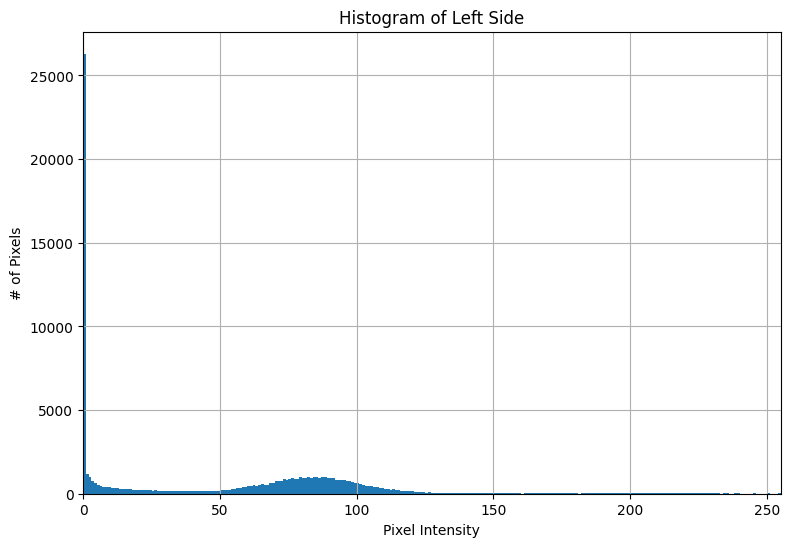

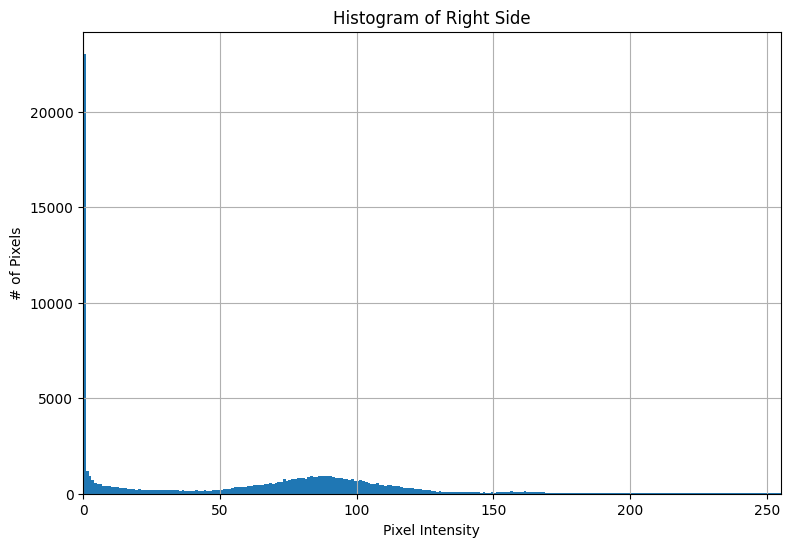

In [1463]:
# Histogram of each side 
plot_histogram(MRI_1_L, "Histogram of Left Side")
plot_histogram(MRI_1_R, "Histogram of Right Side")

### Put it all together...

In [197]:
# Detecting Brain Tumor and Calculating Score
def detect_brain_tumor(image_address: str, label: str, save_at: str):
    height, width = 350, 400

    # Loading Image
    MRI = cv2.imread(image_address)

    # RGB to GRAY
    MRI = cv2.cvtColor(MRI, cv2.COLOR_RGB2GRAY)

    # Keeping a copy to visualize
    MRI_REAL = MRI.copy()

    # Low Intensity Noise Removal
    MRI[MRI < 20] = 0

    # Getting Brain Position
    (
        upper_limit,
        lower_limit,
        left_limit,
        right_limit,
    ) = brain_position(MRI)

    # Positioning the Brain in MRI Image
    MRI = MRI[upper_limit:-lower_limit, left_limit:-right_limit]
    MRI_REAL = MRI_REAL[upper_limit:-lower_limit, left_limit:-right_limit]

    # Applying Median Blur the MRI Image
    MRI = cv2.medianBlur(MRI, 13)

    # Applying Gaussian Blur the MRI Image
    MRI = cv2.GaussianBlur(MRI, (9, 9), 1)

    # Thresholding the Result
    MRI = cv2.threshold(MRI, 135, 255, cv2.THRESH_BINARY)[1]

    # Resizing
    MRI = cv2.resize(MRI, (height, width))
    MRI_REAL = cv2.resize(MRI_REAL, (height, width))

    # Splitting Tow Sides
    MRI_L = MRI[:, : width // 2]  # Left
    MRI_R = MRI[:, width // 2 :]  # Right

    # Histogram of each Side
    hist_L, bins_L = np.histogram(MRI_L.ravel(), 255, [0, 255])
    hist_R, bins_R = np.histogram(MRI_R.ravel(), 255, [0, 255])

    # Different between histograms and calculating score
    hist_diff = np.array(hist_L - hist_R)
    hist_diff = np.power(np.abs(hist_diff), 2)
    hist_diff = np.sum(hist_diff)
    score = hist_diff / 10000

    # Plotting the results
    plt.figure(figsize=(7, 7))
    plt.imshow(MRI_REAL, cmap="gray")
    if label == "Positive":
        plt.imshow(MRI, cmap="Reds", alpha=0.35)
    plt.axis("off")
    plt.title("Score: {:.2f} | Label: {}".format(score, label.capitalize()))
    plt.tight_layout()
    plt.savefig(save_at + "Result_MRI_{}.jpeg".format(image_address.split("/")[-1].split(".")[0]))
    plt.show()

    return score

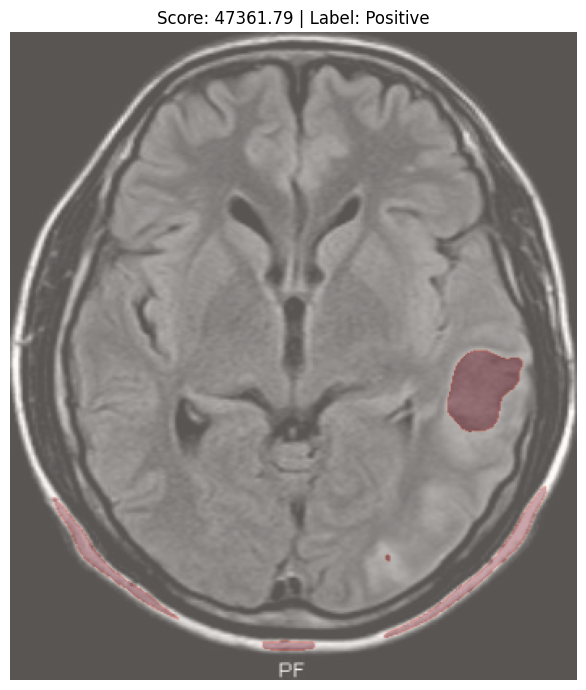

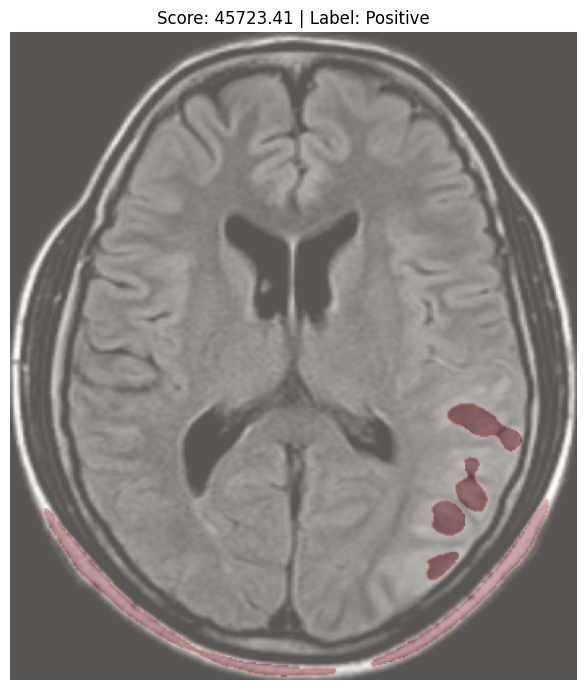

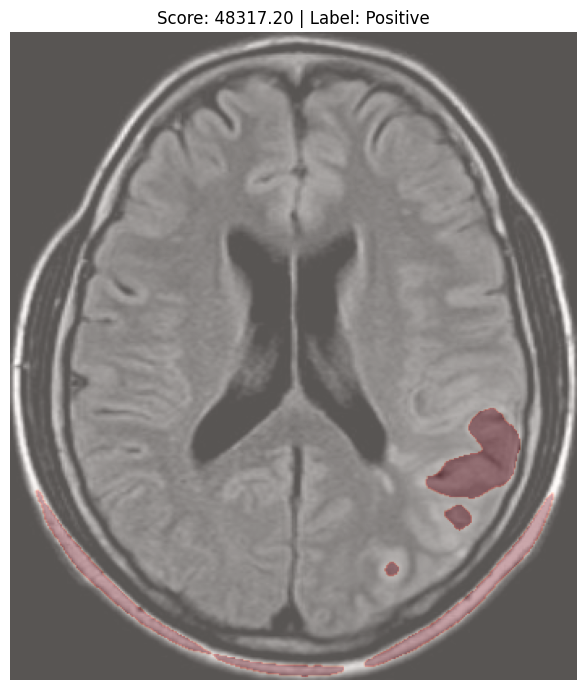

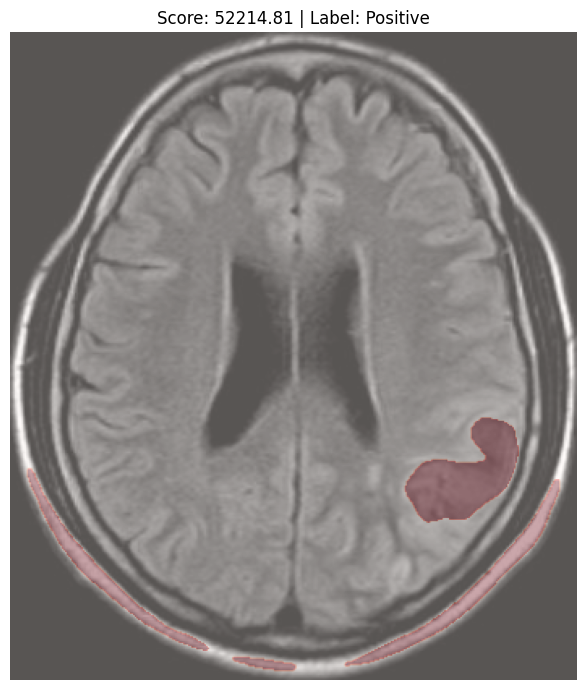

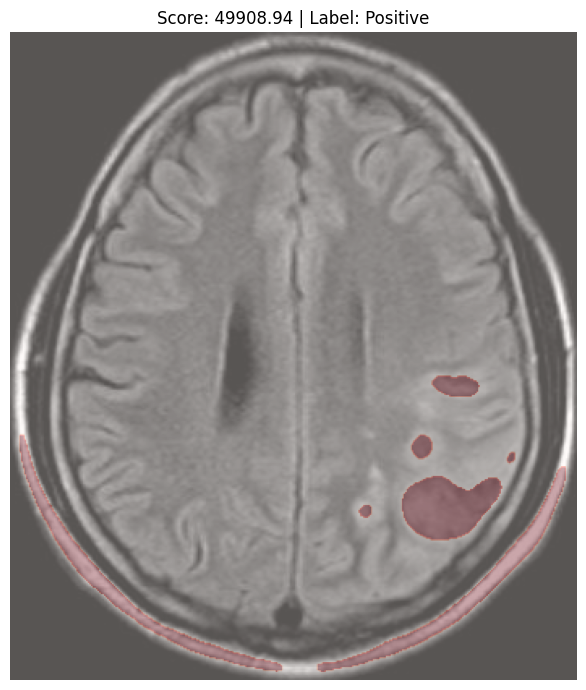

...

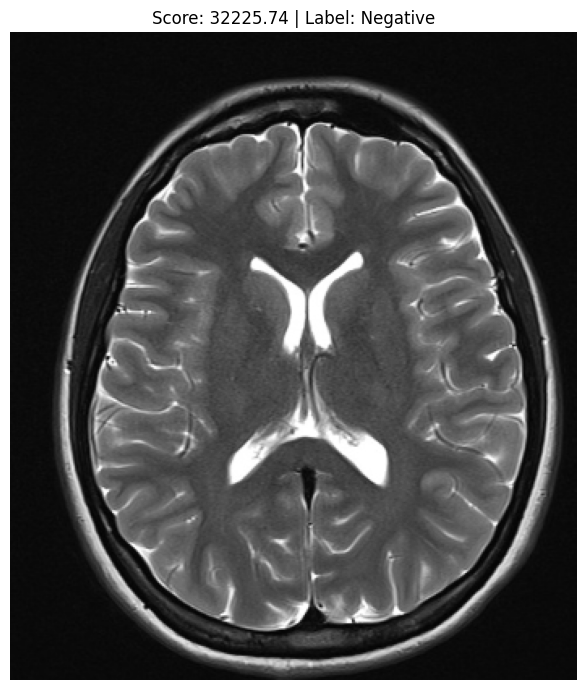

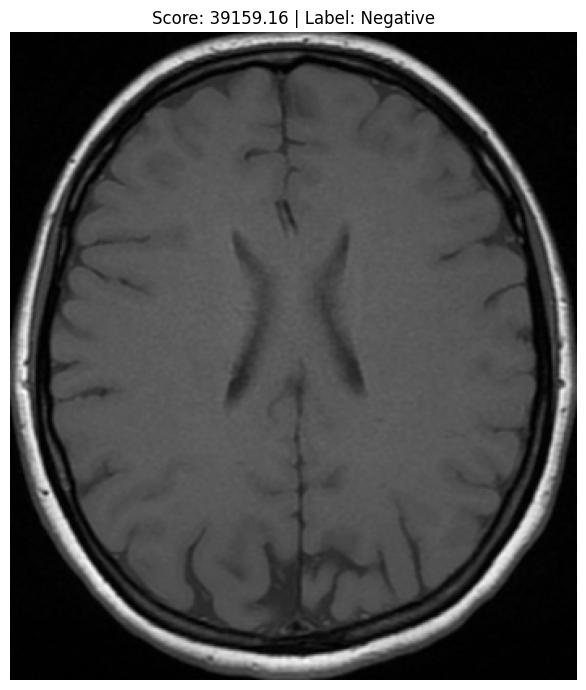

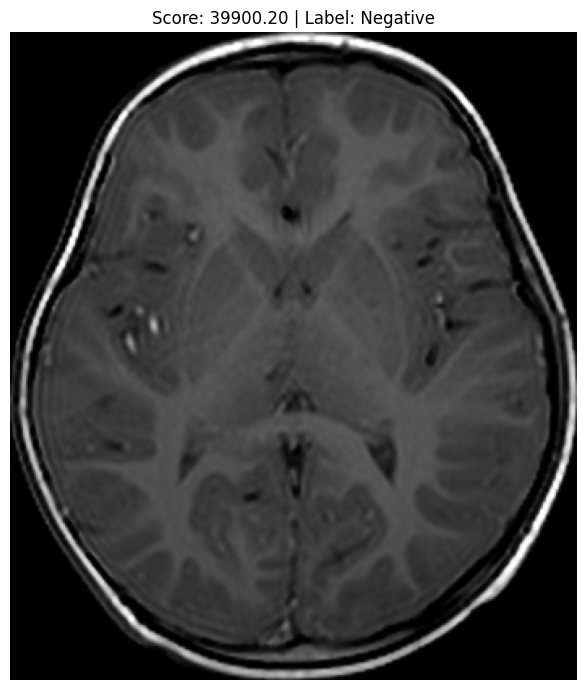

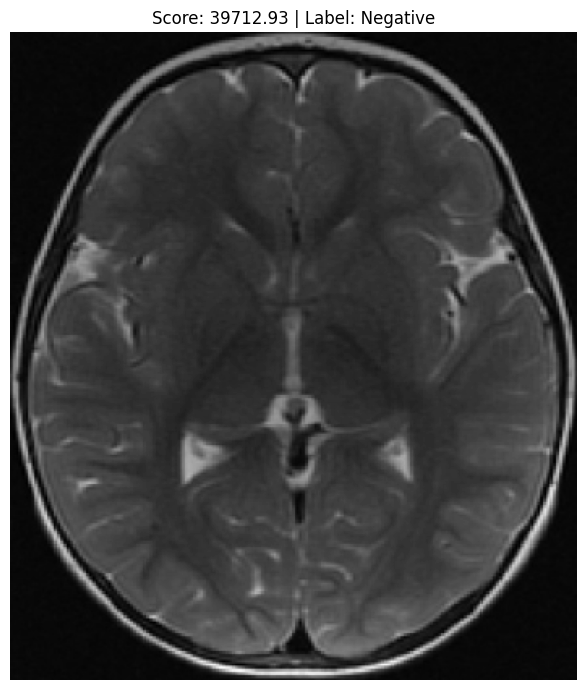

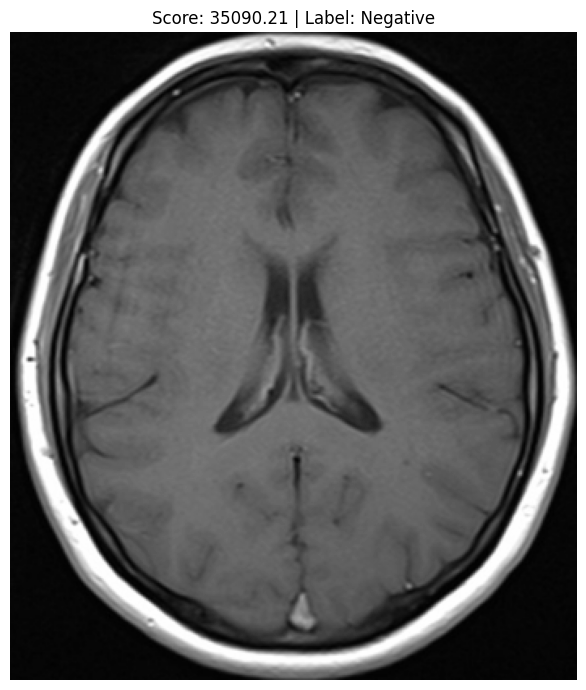

In [198]:
# Address of MRI Images
MRIs = [
    ("Question #5/MRI/1.jpeg", "Positive"),
    ("Question #5/MRI/2.jpeg", "Positive"),
    ("Question #5/MRI/3.jpeg", "Positive"),
    ("Question #5/MRI/4.jpeg", "Positive"),
    ("Question #5/MRI/5.jpeg", "Positive"),
    ("Question #5/MRI/6.jpeg", "Positive"),
    ("Question #5/MRI/7.jpeg", "Positive"),
    # ("Question #5/MRI/8.jpg", "Positive"),
    ("Question #5/MRI/11.png", "Positive"),
    ("Question #5/MRI/9.jpeg", "Negative"),
    ("Question #5/MRI/10.jpeg", "Negative"),
    ("Question #5/MRI/12.jpeg", "Negative"),
    ("Question #5/MRI/13.jpeg", "Negative"),
    ("Question #5/MRI/14.jpeg", "Negative"),
    ("Question #5/MRI/15.jpeg", "Negative"),
    ("Question #5/MRI/16.jpeg", "Negative"),
    ("Question #5/MRI/17.jpeg", "Negative"),
    ("Question #5/MRI/18.jpg", "Negative"),
]
scores = []

# Evaluating Score for each MRI Image
for address, label in MRIs:
    score = detect_brain_tumor(image_address=address, label=label, save_at="Question #5/MRI (Results)/")
    scores.append((score, label))

In [200]:
# Creating DataFrame For Scores
scores = pd.DataFrame(data=scores, columns=["Score", "Label"])
scores = scores.sort_values("Score")
scores

,Score,Label
9,27313.8144,Negative
12,32225.7416,Negative
16,35090.2060,Negative
10,36321.5346,Negative
13,39159.1578,Negative
8,39262.6718,Negative
15,39712.9256,Negative
14,39900.2010,Negative
11,41447.6174,Negative
7,44382.5568,Positive


In [201]:
# Calculating Minimum Score of Positive Scores and Maximum Score of Negative Scores
min_positive_score = scores[scores["Label"] == "Positive"]["Score"].min()
max_negative_score = scores[scores["Label"] == "Negative"]["Score"].max()

# Calculating Margin
margin = min_positive_score - max_negative_score

# Calculating Best Threshold
best_threshold = (max_negative_score + min_positive_score) / 2

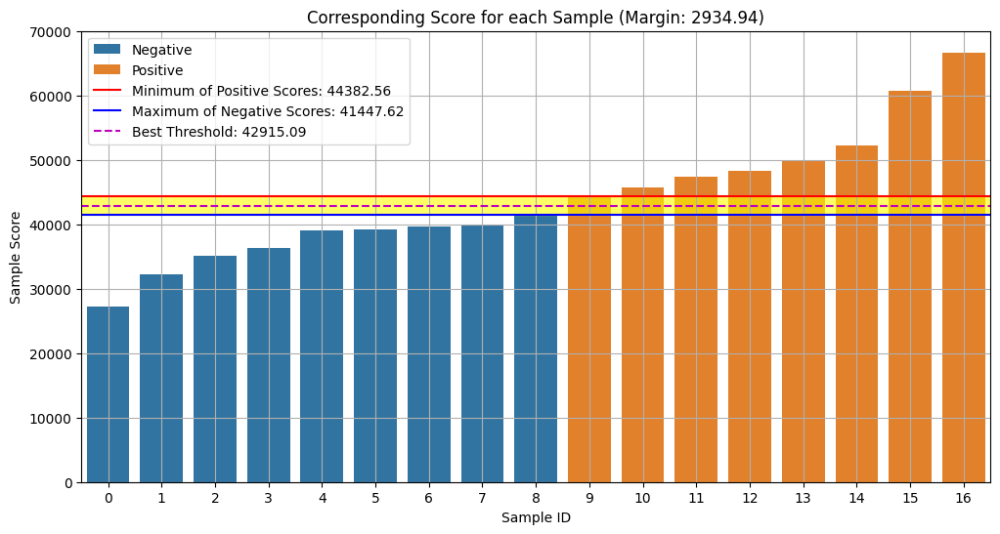

In [203]:
# Visualizing Score of each Instance
plt.figure(figsize=(12, 6))
sns.barplot(scores, y="Score", x=list(range(len(scores))), hue="Label")
plt.axhline(
    y=min_positive_score,
    color="r",
    label="Minimum of Positive Scores: {:.2f}".format(min_positive_score),
)
plt.axhline(
    y=max_negative_score,
    color="b",
    label="Maximum of Negative Scores: {:.2f}".format(max_negative_score),
)
plt.axhspan(max_negative_score, min_positive_score, color="yellow", alpha=0.6)
plt.axhline(
    y=best_threshold,
    color="m",
    linestyle="--",
    label="Best Threshold: {:.2f}".format(best_threshold),
)
plt.xlabel("Sample ID")
plt.ylabel("Sample Score")
plt.title("Corresponding Score for each Sample (Margin: {:.2f})".format(margin))
plt.legend()
plt.grid()
plt.savefig("Question #5/Score of Each MRI Sample and Prediction.jpeg")
plt.show()